# Pre-traitement faisabilité méthodes classiques

## Sommaire

### Importation des modules utilisés

### Chargement des données 

### Nettoyez et transformez la colonne 'product_category_tree' en ne conservant que la première valeur de la variable

- Extraction des deux Principales Valeurs de la Variable 'product_category_tree'

- Visualisation de la distribution des produits selon la première valeur de la Catégorie

- Visualisation de la distribution des produits selon la seconde valeur de la Catégorie

- Mettre à jour la colonne 'product_category_tree' avec la Première Valeur de la Catégorie

## Nettoyage des données

- Mettre en minuscule et suppression des ponctuations

### Tokenisations

- Les 30 premiers tokens dans la colonne "description_tokens"

- Les 30 premiers tokens dans la colonne "product_name_tokens"

- Visualisation de la distribution de l'ensemble des tokens via un nuage de mots

- Garder que les tokens qui sont composés de 100% de lettres alphabétiques

- Visualisation de la distribution des tokens qui sont composés de 100% de lettres alphabétiques via un nuage de mots

### Suppression des Stopwords

- Récupération de la liste des stopwords en anglais

- Élimination des stopwords des colonnes 'description_tokens' et 'product_name_tokens'

- Visualisation des 30 tokens les plus fréquents après suppression des stopwords dans la colonne 'description_tokens'

- Visualisation des 30 tokens les plus fréquents après suppression des stopwords dans la colonne 'product_name_tokens'

- Visualisation de la distribution de l'ensemble des tokens après suppression des stopwords via un nuage de mots

### Lemmatisation

- Application de la lemmatisation sur les tokens de description et de nom de produit

- Visualisation des 30 tokens les plus fréquents dans la colonne 'description_tokens' après lemmatisation 

- Visualisation des 30 tokens les plus fréquents dans la colonne 'product_name_tokens' après lemmatisation 

- Visualisation via un nuage des tokens après lemmatisation

- Visualisation en diagramme en secteurs des 10 tokens les plus fréquents dans la colonne 'description_tokens' après nettoyage 

- Visualisation en diagramme en secteurs des 10 tokens les plus fréquents dans la colonne 'description_tokens' après nettoyage 

### Construire des features du type bag-of-words (à l'aide d'algo CountVectorizer)

- Extraction des caractéristiques de texte en utilisant CountVectorizer sur les descriptions et noms de produits lemmatisés

- Combinaison des caractéristiques textuelles des descriptions et noms de produits pour une représentation unifiée des produits

- Visualisation de la projection 2D des produits utilisant t-SNE sur les caractéristiques textuelles combinées

- Visualisation de la projection 2D des produits avec le clustering K-Means et l'évaluation par l'indice Rand ajusté (ARI)

### Construire des features du type bag-of-words (TfidfVectorizer)

- Extraction des caractéristiques de texte en utilisant CountVectorizer sur les descriptions et noms de produits lemmatisés

- Combinaison des caractéristiques textuelles des descriptions et noms de produits pour une représentation unifiée des produits

- Visualisation de la projection 2D des produits utilisant t-SNE sur les caractéristiques textuelles combinées

- Visualisation de la projection 2D des produits avec le clustering K-Means et l'évaluation par l'indice Rand ajusté (ARI)

## Etude de faisabilité par méthode SIFT

- Chargement des données et comptage du nombre d'images dans le répertoire des photos de Flipkart

### Création des labels des photos à partir du nom des images

- Création d'un DataFrame contenant les chemins des images et les identifiants uniques correspondants

- Jointure du DataFrame contenant les chemins des images avec les identifiants de produit et les catégories correspondantes

- Encodage des catégories de produits en labels numériques

- Compter le nombre d'images par catégorie de produit

### Affichage d'exemples d'images par label

- Affichage d'un exemple d'image pour chaque label

- Affichage de trois exemples d'images pour chaque label

### Détermination et affichage des descripteurs

- Calcul de la taille totale des descripteurs et du nombre total de points clés pour l'ensemble des images

- Affichage d'une image avant l'extraction des points clés SIFT

- Visualisation des points clés SIFT dans une image spécifique et affichage du nombre de points clés et de la dimension des descripteurs

### Pré-traitement des images via SIFT

- Créations des descripteurs de chaque image

- Création des clusters de descripteurs

- Création des features des images

- Réduction de dimension PCA

- Réduction de dimension T-SNE

- Affichage T-SNE selon les catégories d'images

- Clustering des caractéristiques réduites des images avec K-Means et évaluation avec l'index ARI

- Analyse par classes

### Importation des modules utilisés

In [2]:
# Importation des librairies
import pandas as pd
import numpy as np
import missingno as msno
import matplotlib.pyplot as plt
import seaborn as sns

import nltk
from nltk.corpus import stopwords
from nltk.stem import WordNetLemmatizer
from nltk.tokenize import word_tokenize
import string
from wordcloud import WordCloud
from collections import Counter
import re
from nltk.corpus import wordnet
nltk.download('averaged_perceptron_tagger')
nltk.download('wordnet')

import sklearn
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.decomposition import PCA
from sklearn.manifold import TSNE
from sklearn.preprocessing import LabelEncoder
from matplotlib.colors import ListedColormap
from scipy.sparse import hstack

from sklearn.cluster import KMeans
from sklearn.metrics import adjusted_rand_score

from tqdm import tqdm
from os import listdir
from sklearn import preprocessing

import cv2, time
from os.path import join
from glob import glob
import random
from sklearn import manifold, decomposition
from sklearn import cluster, metrics
import os
from PIL import Image
import matplotlib.image as mpimg
from sklearn.cluster import MiniBatchKMeans

<frozen importlib._bootstrap>:228: RuntimeWarning: scipy._lib.messagestream.MessageStream size changed, may indicate binary incompatibility. Expected 56 from C header, got 64 from PyObject
[nltk_data] Downloading package averaged_perceptron_tagger to
[nltk_data]     C:\Users\tidib\AppData\Roaming\nltk_data...
[nltk_data]   Package averaged_perceptron_tagger is already up-to-
[nltk_data]       date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\tidib\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!


In [1]:
import sys
print(sys.version)

3.9.13 (main, Aug 25 2022, 23:51:50) [MSC v.1916 64 bit (AMD64)]


In [218]:
pip install wordcloud

     ------------------------------------ 153.3/153.3 kB 203.2 kB/s eta 0:00:00
Note: you may need to restart the kernel to use updated packages.


### Chargement des données 

In [3]:
flipkart_df = pd.read_csv('./data/Flipkart/flipkart_com-ecommerce_sample_1050.csv')

In [3]:
flipkart_df.columns

Index(['uniq_id', 'crawl_timestamp', 'product_url', 'product_name',
       'product_category_tree', 'pid', 'retail_price', 'discounted_price',
       'image', 'is_FK_Advantage_product', 'description', 'product_rating',
       'overall_rating', 'brand', 'product_specifications'],
      dtype='object')

In [4]:
flipkart_df.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."


In [5]:
flipkart_df.tail()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
1045,958f54f4c46b53c8a0a9b8167d9140bc,2015-12-01 10:15:43 +0000,http://www.flipkart.com/oren-empower-extra-lar...,Oren Empower Extra Large Self Adhesive Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIE88ZGTX65GH4V,1399.0,999.0,958f54f4c46b53c8a0a9b8167d9140bc.jpg,False,Oren Empower Extra Large Self Adhesive Sticker...,No rating available,No rating available,Oren Empower,"{""product_specification""=>[{""key""=>""Number of ..."
1046,fd6cbcc22efb6b761bd564c28928483c,2015-12-01 10:15:43 +0000,http://www.flipkart.com/wallmantra-large-vinyl...,Wallmantra Large Vinyl Sticker Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIEC889ZD5GDCVQ,4930.0,1896.0,fd6cbcc22efb6b761bd564c28928483c.jpg,False,Wallmantra Large Vinyl Sticker Sticker (Pack o...,No rating available,No rating available,Wallmantra,"{""product_specification""=>[{""key""=>""Number of ..."
1047,5912e037d12774bb73a2048f35a00009,2015-12-01 10:15:43 +0000,http://www.flipkart.com/uberlyfe-extra-large-p...,Uberlyfe Extra Large Pigmented Polyvinyl Films...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIE5UVGW2JWVWCT,4500.0,1449.0,5912e037d12774bb73a2048f35a00009.jpg,False,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,No rating available,No rating available,Uberlyfe,"{""product_specification""=>[{""key""=>""Number of ..."
1048,c3edc504d1b4f0ba6224fa53a43a7ad6,2015-12-01 10:15:43 +0000,http://www.flipkart.com/wallmantra-medium-viny...,Wallmantra Medium Vinyl Sticker Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIEC889ZGFD3RCE,3465.0,1333.0,c3edc504d1b4f0ba6224fa53a43a7ad6.jpg,False,Buy Wallmantra Medium Vinyl Sticker Sticker fo...,No rating available,No rating available,Wallmantra,"{""product_specification""=>[{""key""=>""Number of ..."
1049,f2f027ad6a6df617c9f125173da71e44,2015-12-01 10:15:43 +0000,http://www.flipkart.com/uberlyfe-large-vinyl-s...,Uberlyfe Large Vinyl Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIE2ZEPACRQJKH7,1190.0,595.0,f2f027ad6a6df617c9f125173da71e44.jpg,False,Buy Uberlyfe Large Vinyl Sticker for Rs.595 on...,4,4,Uberlyfe,"{""product_specification""=>[{""key""=>""Sales Pack..."


In [5]:
flipkart_df.shape

(1050, 15)

In [6]:
flipkart_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1050 entries, 0 to 1049
Data columns (total 15 columns):
 #   Column                   Non-Null Count  Dtype  
---  ------                   --------------  -----  
 0   uniq_id                  1050 non-null   object 
 1   crawl_timestamp          1050 non-null   object 
 2   product_url              1050 non-null   object 
 3   product_name             1050 non-null   object 
 4   product_category_tree    1050 non-null   object 
 5   pid                      1050 non-null   object 
 6   retail_price             1049 non-null   float64
 7   discounted_price         1049 non-null   float64
 8   image                    1050 non-null   object 
 9   is_FK_Advantage_product  1050 non-null   bool   
 10  description              1050 non-null   object 
 11  product_rating           1050 non-null   object 
 12  overall_rating           1050 non-null   object 
 13  brand                    712 non-null    object 
 14  product_specifications  

In [7]:
flipkart_df.dtypes.value_counts()

object     12
float64     2
bool        1
dtype: int64

In [32]:
flipkart_df

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,"[""Home Furnishing >> Curtains & Accessories >>...",CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa..."
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,"[""Baby Care >> Baby Bath & Skin >> Baby Bath T...",BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",..."
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v..."
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,"[""Home Furnishing >> Bed Linen >> Bedsheets >>...",BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa..."
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc,2015-12-01 10:15:43 +0000,http://www.flipkart.com/oren-empower-extra-lar...,Oren Empower Extra Large Self Adhesive Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIE88ZGTX65GH4V,1399.0,999.0,958f54f4c46b53c8a0a9b8167d9140bc.jpg,False,Oren Empower Extra Large Self Adhesive Sticker...,No rating available,No rating available,Oren Empower,"{""product_specification""=>[{""key""=>""Number of ..."
1046,fd6cbcc22efb6b761bd564c28928483c,2015-12-01 10:15:43 +0000,http://www.flipkart.com/wallmantra-large-vinyl...,Wallmantra Large Vinyl Sticker Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIEC889ZD5GDCVQ,4930.0,1896.0,fd6cbcc22efb6b761bd564c28928483c.jpg,False,Wallmantra Large Vinyl Sticker Sticker (Pack o...,No rating available,No rating available,Wallmantra,"{""product_specification""=>[{""key""=>""Number of ..."
1047,5912e037d12774bb73a2048f35a00009,2015-12-01 10:15:43 +0000,http://www.flipkart.com/uberlyfe-extra-large-p...,Uberlyfe Extra Large Pigmented Polyvinyl Films...,"[""Baby Care >> Baby & Kids Gifts >> Stickers >...",STIE5UVGW2JWVWCT,4500.0,1449.0,5912e037d12774bb73a2048f35a00009.jpg,False,Buy Uberlyfe Extra Large Pigmented Polyvinyl F...,No rating available,No rating available,Uberlyfe,"{""product_specification""=>[{""key""=>""Number of ..."
1048,c3edc504d1b4f0ba6224fa53a43a7ad6,2015-12-01 10:15:43 +0000,http://www.flipkart.com/wallmantra-medium-viny...,Wallmantra Medium Vinyl Sticker Sticker,"[""Baby Care >> Baby & Kids Gifts >> Stickers >.

In [8]:
flipkart_df.nunique()

uniq_id                    1050
crawl_timestamp             149
product_url                1050
product_name               1050
product_category_tree       642
pid                        1050
retail_price                354
discounted_price            424
image                      1050
is_FK_Advantage_product       2
description                1050
product_rating               27
overall_rating               27
brand                       490
product_specifications      984
dtype: int64

### Nettoyez et transformez la colonne 'product_category_tree' en ne conservant que la première valeur de la variable

In [4]:
flipkart_df['product_category_tree'][0]

'["Home Furnishing >> Curtains & Accessories >> Curtains >> Elegance Polyester Multicolor Abstract Eyelet Do..."]'

- Extraction des Deux Principales Valeurs de la Variable 'product_category_tree'

In [5]:
list_first_category, list_second_category = [], []

for txt in flipkart_df["product_category_tree"]:
    list_first_category.append(txt.split(">>")[0].split("\"")[1].strip()) # split du nom par >> et on récupère la première partie
    
    # Assurez-vous que la catégorie 2 existe avant d'essayer de la récupérer
    if ">>" in txt:
        list_second_category.append(txt.split(">>")[1].strip()) 
    else:
        list_second_category.append(None)  # ou une valeur par défaut, si la deuxième catégorie n'existe pas 

# Création d'une nouvelle série catégorie    
flipkart_df["first_category"] = pd.Series(list_first_category)
flipkart_df["second_category"] = pd.Series(list_second_category)

print("Nombre de première catégorie est de {}, Nombre de deuxième catégorie est de {} ".format(flipkart_df["first_category"].nunique(), flipkart_df["second_category"].nunique()))

Nombre de première catégorie est de 7, Nombre de deuxième catégorie est de 63 


- Visualisation de la distribution des produits selon la première valeur de la Catégorie

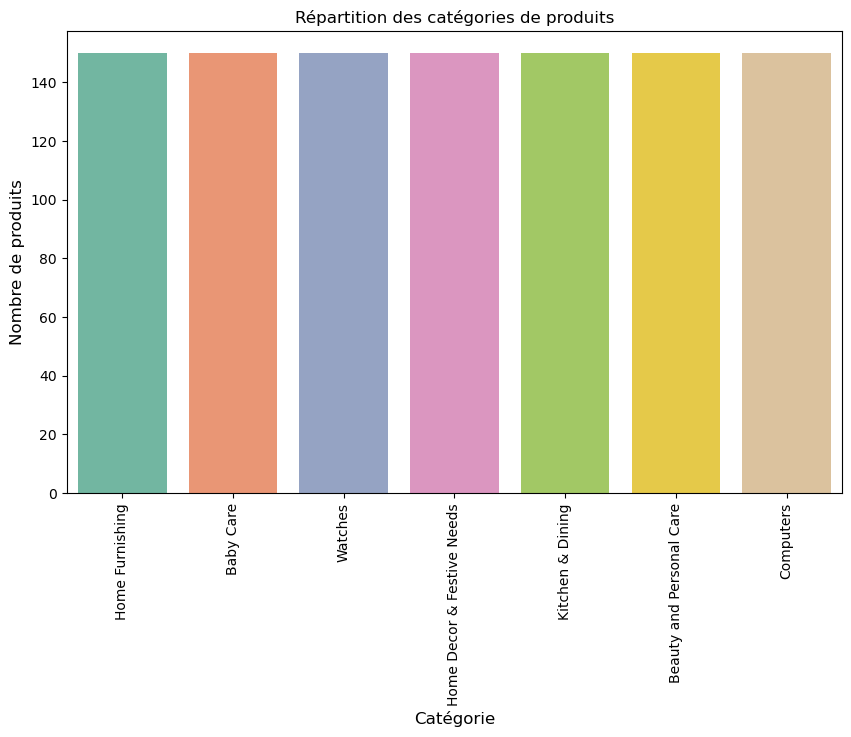

In [6]:
# Comptage du nombre d'occurrences de chaque catégorie
category_counts = flipkart_df['first_category'].value_counts()

# Création du graphique à barres
plt.figure(figsize=(10,6)) 
sns.barplot(x=category_counts.index, y=category_counts.values, palette="Set2")
plt.title('Répartition des catégories de produits')
plt.ylabel('Nombre de produits', fontsize=12)
plt.xlabel('Catégorie', fontsize=12)
plt.xticks(rotation=90)
plt.savefig('categories1_produits.png')
plt.show()

- Visualisation de la distribution des produits selon la seconde valeur de la Catégorie

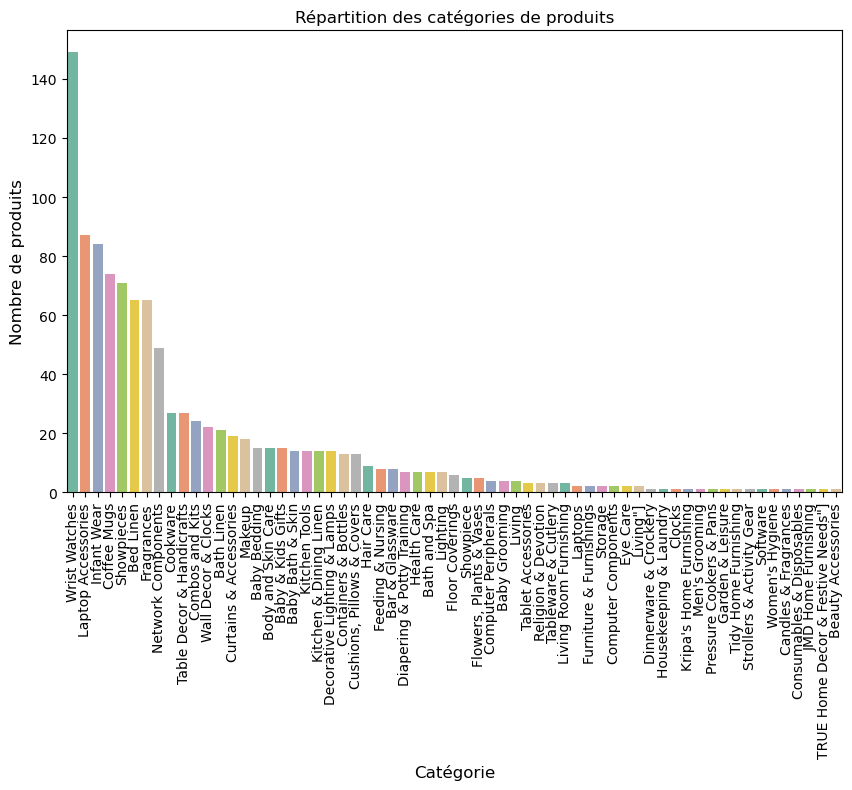

In [42]:
# Comptage du nombre d'occurrences de chaque catégorie
category_counts = flipkart_df['second_category'].value_counts()

# Création du graphique à barres
plt.figure(figsize=(10,6)) 
sns.barplot(x=category_counts.index, y=category_counts.values, palette="Set2")
plt.title('Répartition des catégories de produits')
plt.ylabel('Nombre de produits', fontsize=12)
plt.xlabel('Catégorie', fontsize=12)
plt.xticks(rotation=90)
plt.savefig('categories2_produits.png')
plt.show()

- Mettre à jour la colonne 'product_category_tree' avec la première valeur de la Catégorie

In [7]:
# Mettre à jour la colonne 'product_category_tree' avec les valeurs de la 'first_category'
flipkart_df['product_category_tree'] = flipkart_df['first_category']

In [37]:
flipkart_df['product_category_tree'].unique()

array(['Home Furnishing', 'Baby Care', 'Watches',
       'Home Decor & Festive Needs', 'Kitchen & Dining',
       'Beauty and Personal Care', 'Computers'], dtype=object)

In [38]:
flipkart_df['product_category_tree'].nunique()

7

In [39]:
# Trouver les valeurs manquantes dans la colonne 'category'
missing_values = flipkart_df['product_category_tree'].isnull().sum()

# Afficher le nombre de valeurs manquantes
print(f"Nombre de valeurs manquantes dans la colonne 'product_category_tree': {missing_values}")

Nombre de valeurs manquantes dans la colonne 'product_category_tree': 0


In [44]:
flipkart_df.head()

,uniq_id,crawl_timestamp,product_url,product_name,product_category_tree,pid,retail_price,discounted_price,image,is_FK_Advantage_product,description,product_rating,overall_rating,brand,product_specifications,category_1,category_2,first_category,second_category
0,55b85ea15a1536d46b7190ad6fff8ce7,2016-04-30 03:22:56 +0000,http://www.flipkart.com/elegance-polyester-mul...,Elegance Polyester Multicolor Abstract Eyelet ...,Home Furnishing,CRNEG7BKMFFYHQ8Z,1899.0,899.0,55b85ea15a1536d46b7190ad6fff8ce7.jpg,False,Key Features of Elegance Polyester Multicolor ...,No rating available,No rating available,Elegance,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Furnishing,Curtains & Accessories,Home Furnishing,Curtains & Accessories
1,7b72c92c2f6c40268628ec5f14c6d590,2016-04-30 03:22:56 +0000,http://www.flipkart.com/sathiyas-cotton-bath-t...,Sathiyas Cotton Bath Towel,Baby Care,BTWEGFZHGBXPHZUH,600.0,449.0,7b72c92c2f6c40268628ec5f14c6d590.jpg,False,Specifications of Sathiyas Cotton Bath Towel (...,No rating available,No rating available,Sathiyas,"{""product_specification""=>[{""key""=>""Machine Wa...",Baby Care,Baby Bath & Skin,Baby Care,Baby Bath & Skin
2,64d5d4a258243731dc7bbb1eef49ad74,2016-04-30 03:22:56 +0000,http://www.flipkart.com/eurospa-cotton-terry-f...,Eurospa Cotton Terry Face Towel Set,Baby Care,BTWEG6SHXTDB2A2Y,NaN,NaN,64d5d4a258243731dc7bbb1eef49ad74.jpg,False,Key Features of Eurospa Cotton Terry Face Towe...,No rating available,No rating available,Eurospa,"{""product_specification""=>[{""key""=>""Material"",...",Baby Care,Baby Bath & Skin,Baby Care,Baby Bath & Skin
3,d4684dcdc759dd9cdf41504698d737d8,2016-06-20 08:49:52 +0000,http://www.flipkart.com/santosh-royal-fashion-...,SANTOSH ROYAL FASHION Cotton Printed King size...,Home Furnishing,BDSEJT9UQWHDUBH4,2699.0,1299.0,d4684dcdc759dd9cdf41504698d737d8.jpg,False,Key Features of SANTOSH ROYAL FASHION Cotton P...,No rating available,No rating available,SANTOSH ROYAL FASHION,"{""product_specification""=>[{""key""=>""Brand"", ""v...",Home Furnishing,Bed Linen,Home Furnishing,Bed Linen
4,6325b6870c54cd47be6ebfbffa620ec7,2016-06-20 08:49:52 +0000,http://www.flipkart.com/jaipur-print-cotton-fl...,Jaipur Print Cotton Floral King sized Double B...,Home Furnishing,BDSEJTHNGWVGWWQU,2599.0,698.0,6325b6870c54cd47be6ebfbffa620ec7.jpg,False,Key Features of Jaipur Print Cotton Floral Kin...,No rating available,No rating available,Jaipur Print,"{""product_specification""=>[{""key""=>""Machine Wa...",Home Furnishing,Bed Linen,Home Furnishing,Bed Linen


In [13]:
flipkart_df.nunique()

uniq_id                    1050
crawl_timestamp             149
product_url                1050
product_name               1050
product_category_tree         7
pid                        1050
retail_price                354
discounted_price            424
image                      1050
is_FK_Advantage_product       2
description                1050
product_rating               27
overall_rating               27
brand                       490
product_specifications      984
dtype: int64

In [8]:
flipkart_img_df = flipkart_df[['image', 'product_category_tree']].copy()

In [91]:
# Sauvegarde du jeu de données
flipkart_img_df.to_csv('data/Flipkart/flipkart_img_df.csv',index=False )

In [9]:
flipkart_id_cat_df = flipkart_df[['uniq_id', 'product_category_tree']]

In [93]:
# Sauvegarde du jeu de données
flipkart_id_cat_df.to_csv('data/Flipkart/flipkart_id_cat_df.csv',index=False )

- Selection des colonnes utiles pour la suite du traitement

In [10]:
flipkart_df = flipkart_df[['product_name', 'description', 'uniq_id','product_category_tree']]
flipkart_df.sample(10)

,product_name,description,uniq_id,product_category_tree
238,Metallino Hard Anodised Kadhai 1.2 L,Buy Metallino Hard Anodised Kadhai 1.2 L for R...,2e8df36b35d22cf219cf8bae6c2af752,Kitchen & Dining
116,Recrafto Buddha Showpiece - 15.24 cm,"Recrafto Buddha Showpiece - 15.24 cm (Brass,...",53f4bc7d7321f5c41de6b86e41f13e80,Home Decor & Festive Needs
786,Perucci PC-122 Decker Analog Watch - For Men,Perucci PC-122 Decker Analog Watch - For Men ...,c705a5735a94aeee547d1798e3e46ec4,Watches
595,"Mayursflora Bonsai Aloe, Maple, Arecaceae, Pal...","Specifications of Mayursflora Bonsai Aloe, Map...",dde89969aecfa2c5245e8059c660b139,Home Decor & Festive Needs
735,AntiqueShop ABKL_GRN_GRN_GRN,Key Features of AntiqueShop ABKL_GRN_GRN_GRN S...,aa82b75da7579007963e53b6f818281b,Beauty and Personal Care
961,FURNISHINGLAND Green Silk Carpet,Key Features of FURNISHINGLAND Green Silk Carp...,cf6a4daf0e795838061b0eb832bbc99d,Home Furnishing
931,Jaipur Textile Hub Floral Double Quilts & Comf...,Buy Jaipur Textile Hub Floral Double Quilts & ...,60395c709b4a933319e2713e3ae620d4,Home Furnishing
244,Bergner Kadhai NA L,"Bergner Kadhai NA L (Aluminium, Non-stick)\r\n...",0c4718ae90f2889b7021a99ee1cc106c,Kitchen & Dining
912,Bourne Supermacy Canvas Art,Key Features of Bourne Supermacy Canvas Art Un...,e225be101bbad1ea9d031261ba4387b8,Home Decor & Festive Needs
274,Supreme Cookwares Kadhai 1.5 L,Buy Supreme Cookwares Kadhai 1.5 L for Rs.799 ...,c3e1435782c0929327449eec11475b96,Kitchen & Dining


### Sauvegarde du dataset à ce niveau pour d'autres traitements ultérieures 

In [95]:
flipkart_df.to_csv('data/Flipkart/flipkart_target.csv', index=False)

In [67]:
doc = flipkart_df.product_name.sample(1)
doc = doc.values[0]
doc

'Offspring Printed Single Blanket Blue'

In [68]:
doc = doc.lower()
doc

'offspring printed single blanket blue'

In [69]:
tokens = word_tokenize(doc)
tokens

['offspring', 'printed', 'single', 'blanket', 'blue']

In [13]:
flipkart_df.isna().sum()

uniq_id                  0
product_name             0
description              0
product_category_tree    0
dtype: int64

In [14]:
flipkart_df.nunique()

uniq_id                  1050
product_name             1050
description              1050
product_category_tree       7
dtype: int64

In [120]:
nltk.download('stopwords')
nltk.download('punkt')
nltk.download('wordnet')
nltk.download('omw-1.4')
nltk.download('words')

[nltk_data] Downloading package stopwords to
[nltk_data]     C:\Users\tidib\AppData\Roaming\nltk_data...
[nltk_data]   Package stopwords is already up-to-date!
[nltk_data] Downloading package punkt to
[nltk_data]     C:\Users\tidib\AppData\Roaming\nltk_data...
[nltk_data]   Package punkt is already up-to-date!
[nltk_data] Downloading package wordnet to
[nltk_data]     C:\Users\tidib\AppData\Roaming\nltk_data...
[nltk_data]   Package wordnet is already up-to-date!
[nltk_data] Downloading package omw-1.4 to
[nltk_data]     C:\Users\tidib\AppData\Roaming\nltk_data...
[nltk_data] Downloading package words to
[nltk_data]     C:\Users\tidib\AppData\Roaming\nltk_data...
[nltk_data]   Unzipping corpora\words.zip.


True

In [8]:
flipkart_df['description'].iloc[0]

'Key Features of Elegance Polyester Multicolor Abstract Eyelet Door Curtain Floral Curtain,Elegance Polyester Multicolor Abstract Eyelet Door Curtain (213 cm in Height, Pack of 2) Price: Rs. 899 This curtain enhances the look of the interiors.This curtain is made from 100% high quality polyester fabric.It features an eyelet style stitch with Metal Ring.It makes the room environment romantic and loving.This curtain is ant- wrinkle and anti shrinkage and have elegant apparance.Give your home a bright and modernistic appeal with these designs. The surreal attention is sure to steal hearts. These contemporary eyelet and valance curtains slide smoothly so when you draw them apart first thing in the morning to welcome the bright sun rays you want to wish good morning to the whole world and when you draw them close in the evening, you create the most special moments of joyous beauty given by the soothing prints. Bring home the elegant curtain that softly filters light in your room so that you

## Nettoyage des données

### 1.1. Mettre en minuscule et suppression des ponctuations

In [96]:
# Mettre tout le texte en minuscule dans les colonnes "description" et "product_name"
flipkart_df['description'] = flipkart_df['description'].str.lower()
flipkart_df['product_name'] = flipkart_df['product_name'].str.lower()

# Supprimer la ponctuation dans les colonnes "description" et "product_name"
flipkart_df['description'] = flipkart_df['description'].str.replace('[^\w\s]', '', regex=True)
flipkart_df['product_name'] = flipkart_df['product_name'].str.replace('[^\w\s]', '', regex=True)


### 1.2. Tokenisations

In [97]:
# Tokenisation des colonnes "description" et "product_name"
flipkart_df['description_tokens'] = flipkart_df['description'].apply(word_tokenize)
flipkart_df['product_name_tokens'] = flipkart_df['product_name'].apply(word_tokenize)

# Affichage des résultats
for index, row in flipkart_df.iterrows():
    print(f"Description Tokens: {row['description_tokens']}")
    print(f"Product Name Tokens: {row['product_name_tokens']}")
    print("-------------------------------")

Description Tokens: ['key', 'features', 'of', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtainelegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', '213', 'cm', 'in', 'height', 'pack', 'of', '2', 'price', 'rs', '899', 'this', 'curtain', 'enhances', 'the', 'look', 'of', 'the', 'interiorsthis', 'curtain', 'is', 'made', 'from', '100', 'high', 'quality', 'polyester', 'fabricit', 'features', 'an', 'eyelet', 'style', 'stitch', 'with', 'metal', 'ringit', 'makes', 'the', 'room', 'environment', 'romantic', 'and', 'lovingthis', 'curtain', 'is', 'ant', 'wrinkle', 'and', 'anti', 'shrinkage', 'and', 'have', 'elegant', 'apparancegive', 'your', 'home', 'a', 'bright', 'and', 'modernistic', 'appeal', 'with', 'these', 'designs', 'the', 'surreal', 'attention', 'is', 'sure', 'to', 'steal', 'hearts', 'these', 'contemporary', 'eyelet', 'and', 'valance', 'curtains', 'slide', 'smoothly', 'so', 'when', 'you', 'draw', 'them', 'apart', 'f

- Compter les occurrences de chaque token

In [98]:
# Compter les occurrences de chaque token dans la colonne "description_tokens"
description_counts = Counter(token for tokens in flipkart_df['description_tokens'] for token in tokens)

# Compter les occurrences de chaque token dans la colonne "product_name_tokens"
product_name_counts = Counter(token for tokens in flipkart_df['product_name_tokens'] for token in tokens)

# Trier les tokens par ordre décroissant d'occurrences
description_sorted = description_counts.most_common()
product_name_sorted = product_name_counts.most_common()

# Afficher les résultats triés
print("Tokens dans la colonne 'description_tokens', classés par ordre décroissant d'occurrences:")
for token, count in description_sorted:
    print(f"{token}: {count}")

print("\nTokens dans la colonne 'product_name_tokens', classés par ordre décroissant d'occurrences:")
for token, count in product_name_sorted:
    print(f"{token}: {count}")

Tokens dans la colonne 'description_tokens', classés par ordre décroissant d'occurrences:
of: 1747
for: 1433
the: 1360
and: 1332
to: 1055
in: 1041
only: 888
with: 842
on: 832
at: 714
your: 656
a: 637
is: 635
products: 635
free: 612
rs: 594
buy: 581
delivery: 567
genuine: 564
shipping: 564
cash: 564
replacement: 559
day: 538
cm: 515
30: 492
flipkartcom: 472
guarantee: 471
it: 433
this: 430
1: 425
online: 396
features: 394
from: 382
price: 351
you: 334
watch: 330
mug: 319
pack: 317
color: 317
baby: 316
material: 305
type: 303
set: 303
box: 289
general: 288
cotton: 286
package: 268
sales: 261
analog: 255
number: 249
warranty: 244
quality: 242
girls: 237
details: 235
brand: 232
best: 230
product: 226
model: 220
ceramic: 217
key: 215
design: 215
are: 215
laptop: 212
prices: 208
fabric: 206
showpiece: 206
be: 205
can: 197
or: 191
great: 189
not: 186
made: 185
perfect: 184
that: 183
boys: 183
india: 180
men: 176
usb: 174
2: 172
size: 172
inch: 168
multicolor: 167
dimensions: 167
ideal: 167
ho

- Les 30 premiers tokens dans la colonne "description_tokens"

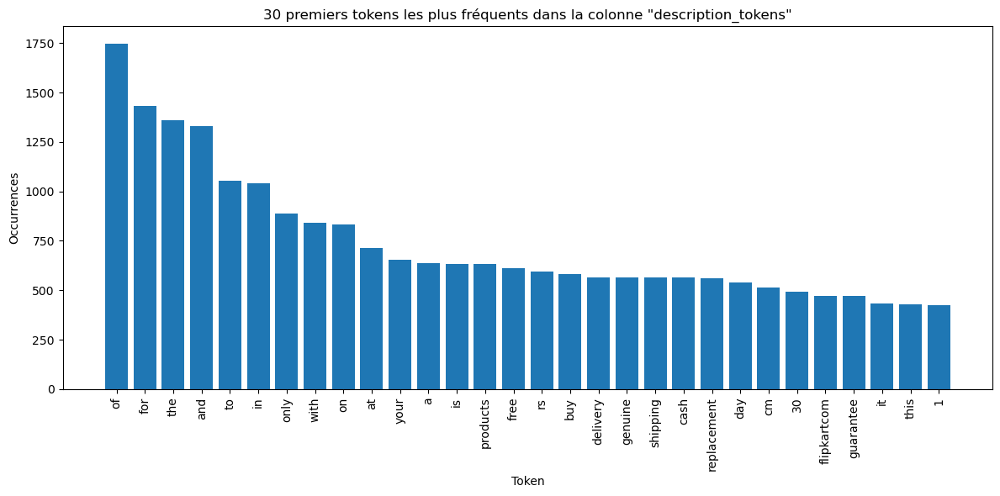

In [100]:
# Compter les occurrences de chaque token dans la colonne "description_tokens"
description_counts = Counter(token for tokens in flipkart_df['description_tokens'] for token in tokens)

# Obtenir les 30 premiers tokens les plus fréquents
top_tokens = description_counts.most_common(30)
tokens, counts = zip(*top_tokens)

# Créer le diagramme à barres
plt.figure(figsize=(12, 6))
plt.bar(tokens, counts)
plt.xticks(rotation=90)
plt.xlabel('Token')
plt.ylabel('Occurrences')
plt.title('30 premiers tokens les plus fréquents dans la colonne "description_tokens"')
plt.tight_layout()
plt.savefig('30_description_tokens.png')
plt.show()

- Les 30 premiers tokens dans la colonne "product_name_tokens"

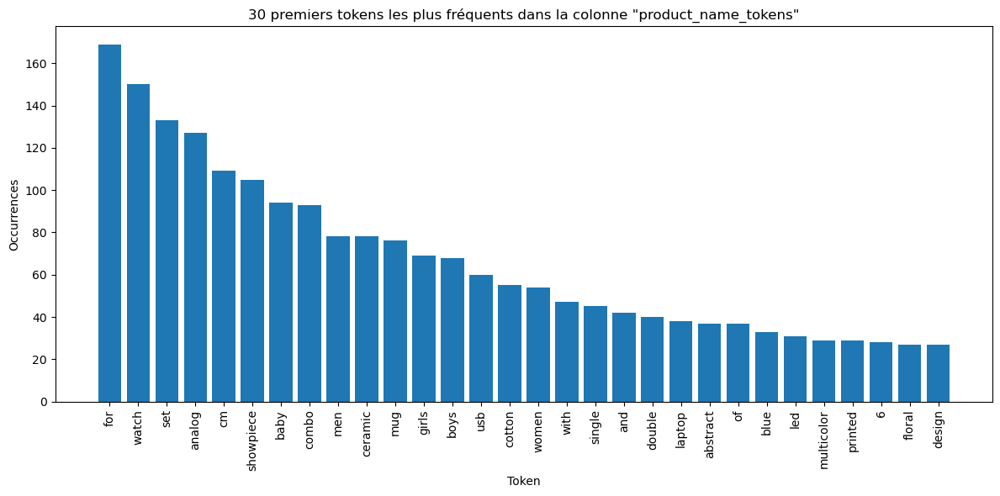

In [101]:
# Compter les occurrences de chaque token dans la colonne "product_name_tokens"
product_name_counts = Counter(token for tokens in flipkart_df['product_name_tokens'] for token in tokens)

# Obtenir les 30 premiers tokens les plus fréquents
top_tokens = product_name_counts.most_common(30)
tokens, counts = zip(*top_tokens)

# Créer le diagramme à barres
plt.figure(figsize=(12, 6))
plt.bar(tokens, counts)
plt.xticks(rotation=90)
plt.xlabel('Token')
plt.ylabel('Occurrences')
plt.title('30 premiers tokens les plus fréquents dans la colonne "product_name_tokens"')
plt.tight_layout()
plt.savefig('30_product_name_tokens.png')
plt.show()

- Visualisation de la distribution de l'ensemble des tokens via un nuage de mots

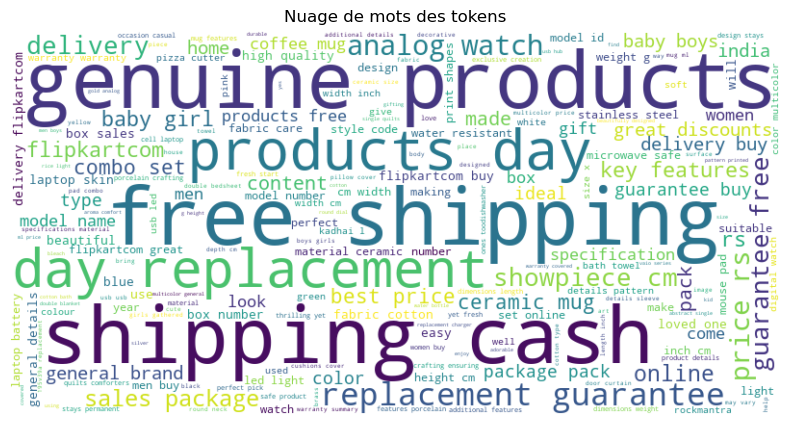

In [102]:
# Concaténer tous les tokens en une seule chaîne de caractères
all_tokens = flipkart_df['description_tokens'].sum() + flipkart_df['product_name_tokens'].sum()
text = ' '.join(all_tokens)

# Créer le nuage de mots
wordcloud = WordCloud(background_color="white", width=800, height=400).generate(text)

# Afficher le nuage de mots
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Nuage de mots des tokens')
plt.savefig('Nuage_de_mots_tokens.png')
plt.show()

- Garder que les tokens qui sont composés de 100% de lettres alphabétiques 

In [103]:
# Fonction pour filtrer les tokens
def filter_alphabetic(tokens):
    return [token for token in tokens if re.match('^[a-zA-Z]+$', token)]

# Filtrer les tokens dans les colonnes "description_tokens" et "product_name_tokens"
flipkart_df['description_tokens'] = flipkart_df['description_tokens'].apply(filter_alphabetic)
flipkart_df['product_name_tokens'] = flipkart_df['product_name_tokens'].apply(filter_alphabetic)

# Affichage des résultats
for index, row in flipkart_df.iterrows():
    print(f"Description Tokens: {row['description_tokens']}")
    print(f"Product Name Tokens: {row['product_name_tokens']}")
    print("-------------------------------")

Description Tokens: ['key', 'features', 'of', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtainelegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'cm', 'in', 'height', 'pack', 'of', 'price', 'rs', 'this', 'curtain', 'enhances', 'the', 'look', 'of', 'the', 'interiorsthis', 'curtain', 'is', 'made', 'from', 'high', 'quality', 'polyester', 'fabricit', 'features', 'an', 'eyelet', 'style', 'stitch', 'with', 'metal', 'ringit', 'makes', 'the', 'room', 'environment', 'romantic', 'and', 'lovingthis', 'curtain', 'is', 'ant', 'wrinkle', 'and', 'anti', 'shrinkage', 'and', 'have', 'elegant', 'apparancegive', 'your', 'home', 'a', 'bright', 'and', 'modernistic', 'appeal', 'with', 'these', 'designs', 'the', 'surreal', 'attention', 'is', 'sure', 'to', 'steal', 'hearts', 'these', 'contemporary', 'eyelet', 'and', 'valance', 'curtains', 'slide', 'smoothly', 'so', 'when', 'you', 'draw', 'them', 'apart', 'first', 'thing', 'in', 'the

- Visualisation de la distribution des tokens qui sont composés de 100% de lettres alphabétiques via un nuage de mots

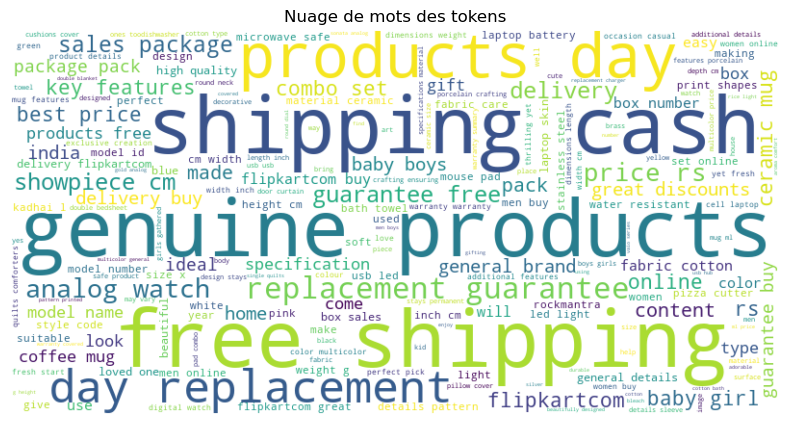

In [105]:
# Concaténer tous les tokens en une seule chaîne de caractères
all_tokens = flipkart_df['description_tokens'].sum() + flipkart_df['product_name_tokens'].sum()
text = ' '.join(all_tokens)

# Créer le nuage de mots
wordcloud = WordCloud(background_color="white", width=800, height=400).generate(text)

# Afficher le nuage de mots
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Nuage de mots des tokens')
plt.savefig('Nuage_de_mots_tokens_only_w.png')
plt.show()

### 1.3. Stopwords

- Récupération de la liste des stopwords en anglais

In [106]:
# Récupérer la liste des stopwords
stop_words = set(stopwords.words('english'))
print(stop_words)

{'after', 'against', 'then', 'she', 'until', 'aren', 'and', 'same', 'nor', 'these', 'if', 'why', 'the', 'y', 'below', 'for', 'm', 'both', 'haven', 'our', 'will', 'should', 're', 'i', 'o', 'hers', "you'd", 'can', 'him', 'off', 'few', 'theirs', "shan't", 'further', 'ain', 'out', 'your', "mustn't", 'ma', "wouldn't", 'all', 'they', "hasn't", 'hasn', 'a', 'is', 'each', 'isn', 'more', 'll', 'those', 'yourselves', 'be', 'ours', 'his', 'yourself', 'he', 'by', 'where', "needn't", 'wasn', 'was', 'from', 'any', 'were', 'ourselves', 'too', "couldn't", 'we', 'being', 'only', "that'll", 'no', 'd', "shouldn't", 'during', 'don', 'hadn', 'had', 'having', 'have', 'needn', 'did', "doesn't", 'as', 'other', 'on', 'doing', 'whom', 'themselves', 'itself', 'very', 'because', 'most', 'do', 'been', "don't", 'such', 'here', 'or', "didn't", 'doesn', 'some', 'above', 'there', 'didn', 'who', "you're", 'to', 'what', 'shan', 'about', 'at', 'weren', 'own', 'just', 'has', 'shouldn', 've', 's', 'down', "you'll", 'throug

- Élimination des stopwords des colonnes 'description_tokens' et 'product_name_tokens

In [107]:
# Fonction pour éliminer les stopwords
def remove_stopwords(tokens):
    return [token for token in tokens if token.lower() not in stop_words]

# Élimination des stopwords dans les colonnes "description_tokens" et "product_name_tokens"
flipkart_df['description_tokens'] = flipkart_df['description_tokens'].apply(remove_stopwords)
flipkart_df['product_name_tokens'] = flipkart_df['product_name_tokens'].apply(remove_stopwords)

# Affichage des résultats
for index, row in flipkart_df.iterrows():
    print(f"Description Tokens: {row['description_tokens']}")
    print(f"Product Name Tokens: {row['product_name_tokens']}")
    print("-------------------------------")

Description Tokens: ['key', 'features', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtainelegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'cm', 'height', 'pack', 'price', 'rs', 'curtain', 'enhances', 'look', 'interiorsthis', 'curtain', 'made', 'high', 'quality', 'polyester', 'fabricit', 'features', 'eyelet', 'style', 'stitch', 'metal', 'ringit', 'makes', 'room', 'environment', 'romantic', 'lovingthis', 'curtain', 'ant', 'wrinkle', 'anti', 'shrinkage', 'elegant', 'apparancegive', 'home', 'bright', 'modernistic', 'appeal', 'designs', 'surreal', 'attention', 'sure', 'steal', 'hearts', 'contemporary', 'eyelet', 'valance', 'curtains', 'slide', 'smoothly', 'draw', 'apart', 'first', 'thing', 'morning', 'welcome', 'bright', 'sun', 'rays', 'want', 'wish', 'good', 'morning', 'whole', 'world', 'draw', 'close', 'evening', 'create', 'special', 'moments', 'joyous', 'beauty', 'given', 'soothing', 'prints', 'bring', 'home',

- Visualisation des 30 tokens les plus fréquents après suppression des stopwords dans la colonne 'description_tokens

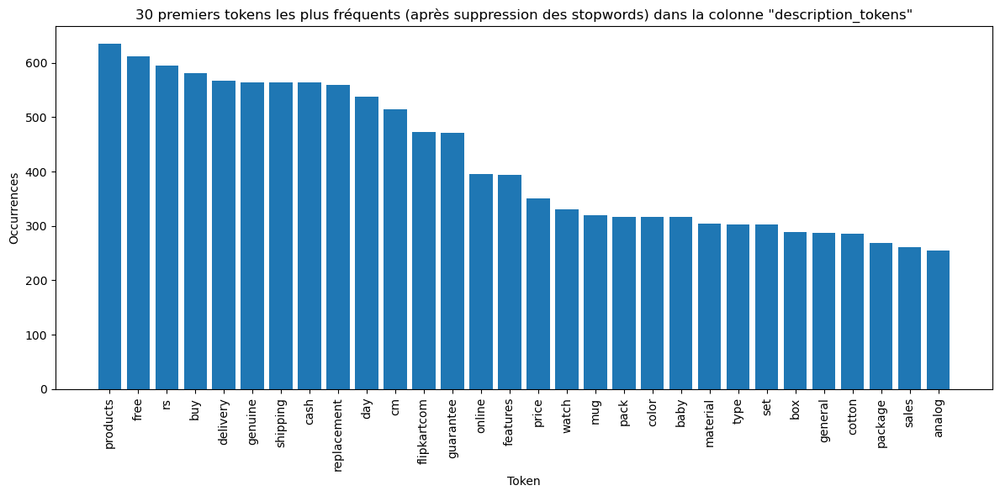

In [108]:
# Compter les occurrences de chaque token dans la colonne "description_tokens" après suppression des stopwords
description_counts = Counter(token for tokens in flipkart_df['description_tokens'] for token in tokens)

# Obtenir les 30 premiers tokens les plus fréquents
top_tokens = description_counts.most_common(30)
tokens, counts = zip(*top_tokens)

# Créer le diagramme à barres
plt.figure(figsize=(12, 6))
plt.bar(tokens, counts)
plt.xticks(rotation=90)
plt.xlabel('Token')
plt.ylabel('Occurrences')
plt.title('30 premiers tokens les plus fréquents (après suppression des stopwords) dans la colonne "description_tokens"')
plt.tight_layout()
plt.savefig('30_description_tokens_stopwords.png')
plt.show()

- Visualisation des 30 tokens les plus fréquents après suppression des stopwords dans la colonne 'product_name_tokens'

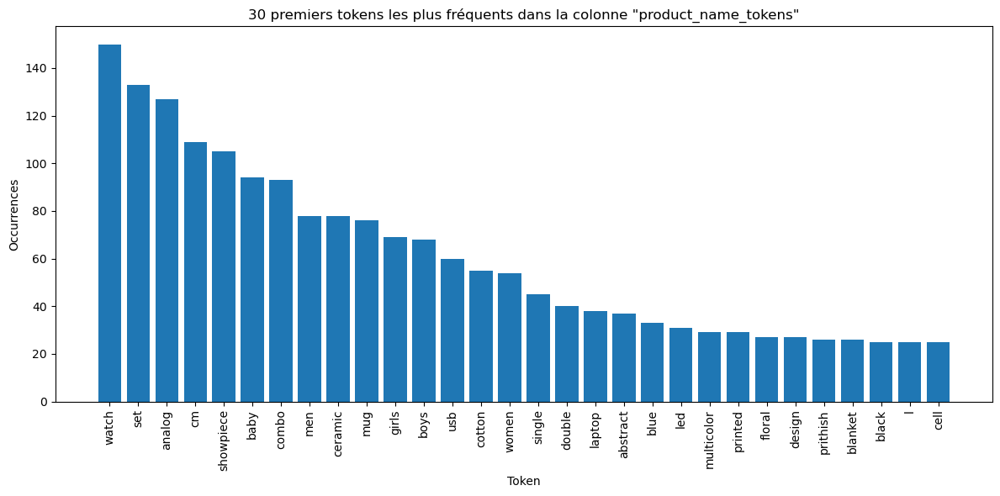

In [109]:
# Compter les occurrences de chaque token dans la colonne "product_name_tokens"
product_name_counts = Counter(token for tokens in flipkart_df['product_name_tokens'] for token in tokens)

# Obtenir les 30 premiers tokens les plus fréquents
top_tokens = product_name_counts.most_common(30)
tokens, counts = zip(*top_tokens)

# Créer le diagramme à barres
plt.figure(figsize=(12, 6))
plt.bar(tokens, counts)
plt.xticks(rotation=90)
plt.xlabel('Token')
plt.ylabel('Occurrences')
plt.title('30 premiers tokens les plus fréquents dans la colonne "product_name_tokens"')
plt.tight_layout()
plt.savefig('30_product_name_tokens_stopwords.png')
plt.show()

- Visualisation de la distribution de l'ensemble des tokens après suppression des stopwords via un nuage de mots

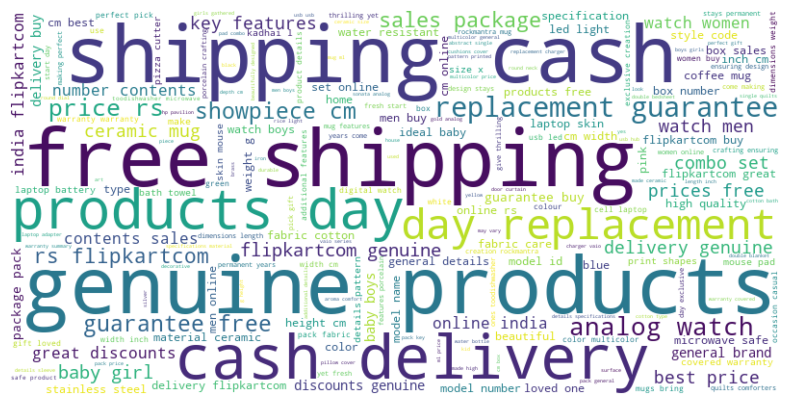

In [110]:
# Concaténer tous les tokens en une seule chaîne de caractères
all_tokens = flipkart_df['description_tokens'].sum() + flipkart_df['product_name_tokens'].sum()
text = ' '.join(all_tokens)

# Créer le nuage de mots
wordcloud = WordCloud(background_color="white", width=800, height=400).generate(text)

# Afficher le nuage de mots
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.savefig('Nuage_de_mots_tokens_stopwords.png')
plt.show()

In [73]:
flipkart_df

,uniq_id,product_name,description,product_category_tree,description_tokens,product_name_tokens
0,55b85ea15a1536d46b7190ad6fff8ce7,elegance polyester multicolor abstract eyelet ...,key features of elegance polyester multicolor ...,Home Furnishing,"[key, features, elegance, polyester, multicolo...","[elegance, polyester, multicolor, abstract, ey..."
1,7b72c92c2f6c40268628ec5f14c6d590,sathiyas cotton bath towel,specifications of sathiyas cotton bath towel 3...,Baby Care,"[specifications, sathiyas, cotton, bath, towel...","[sathiyas, cotton, bath, towel]"
2,64d5d4a258243731dc7bbb1eef49ad74,eurospa cotton terry face towel set,key features of eurospa cotton terry face towe...,Baby Care,"[key, features, eurospa, cotton, terry, face, ...","[eurospa, cotton, terry, face, towel, set]"
3,d4684dcdc759dd9cdf41504698d737d8,santosh royal fashion cotton printed king size...,key features of santosh royal fashion cotton p...,Home Furnishing,"[key, features, santosh, royal, fashion, cotto...","[santosh, royal, fashion, cotton, printed, kin..."
4,6325b6870c54cd47be6ebfbffa620ec7,jaipur print cotton floral king sized double b...,key features of jaipur print cotton floral kin...,Home Furnishing,"[key, features, jaipur, print, cotton, floral,...","[jaipur, print, cotton, floral, king, sized, d..."
...,...,...,...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc,oren empower extra large self adhesive sticker,oren empower extra large self adhesive sticker...,Baby Care,"[oren, empower, extra, large, self, adhesive, ...","[oren, empower, extra, large, self, adhesive, ..."
1046,fd6cbcc22efb6b761bd564c28928483c,wallmantra large vinyl sticker sticker,wallmantra large vinyl sticker sticker pack of...,Baby Care,"[wallmantra, large, vinyl, sticker, sticker, p...","[wallmantra, large, vinyl, sticker, sticker]"
1047,5912e037d12774bb73a2048f35a00009,uberlyfe extra large pigmented polyvinyl films...,buy uberlyfe extra large pigmented polyvinyl f...,Baby Care,"[buy, uberlyfe, extra, large, pigmented, polyv...","[uberlyfe, extra, large, pigmented, polyvinyl,..."
1048,c3edc504d1b4f0ba6224fa53a43a7ad6,wallmantra medium vinyl sticker sticker,buy wallmantra medium vinyl sticker sticker fo...,Baby Care,"[buy, wallmantra, medium, vinyl, sticker, stic...","[wallmantra, medium, vinyl, sticker, sticker]"


### Lemmatisation

- Application de la lemmatisation sur les tokens de description et de nom de produit

In [111]:
# Initialiser le lemmatiseur WordNet
lemmatizer = WordNetLemmatizer()

# Fonction pour obtenir le POS tag correspondant à WordNet
def get_wordnet_pos(tag):
    if tag.startswith('J'):
        return wordnet.ADJ
    elif tag.startswith('V'):                                           
        return wordnet.VERB
    elif tag.startswith('N'):
        return wordnet.NOUN
    elif tag.startswith('R'):
        return wordnet.ADV
    else:
        return wordnet.NOUN  # Par défaut, considérer tous les mots comme des noms

# Lemmatisation des tokens
flipkart_df['description_tokens'] = flipkart_df['description_tokens'].apply(lambda tokens: [lemmatizer.lemmatize(token, get_wordnet_pos(pos_tag)) for token, pos_tag in nltk.pos_tag(tokens)])
flipkart_df['product_name_tokens'] = flipkart_df['product_name_tokens'].apply(lambda tokens: [lemmatizer.lemmatize(token, get_wordnet_pos(pos_tag)) for token, pos_tag in nltk.pos_tag(tokens)])

# Affichage des résultats
for index, row in flipkart_df.iterrows():
    print(f"Description Tokens: {row['description_tokens']}")
    print(f"Product Name Tokens: {row['product_name_tokens']}")
    print("-------------------------------")

Description Tokens: ['key', 'feature', 'elegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'floral', 'curtainelegance', 'polyester', 'multicolor', 'abstract', 'eyelet', 'door', 'curtain', 'cm', 'height', 'pack', 'price', 'r', 'curtain', 'enhances', 'look', 'interiorsthis', 'curtain', 'make', 'high', 'quality', 'polyester', 'fabricit', 'feature', 'eyelet', 'style', 'stitch', 'metal', 'ringit', 'make', 'room', 'environment', 'romantic', 'lovingthis', 'curtain', 'ant', 'wrinkle', 'anti', 'shrinkage', 'elegant', 'apparancegive', 'home', 'bright', 'modernistic', 'appeal', 'design', 'surreal', 'attention', 'sure', 'steal', 'heart', 'contemporary', 'eyelet', 'valance', 'curtain', 'slide', 'smoothly', 'draw', 'apart', 'first', 'thing', 'morning', 'welcome', 'bright', 'sun', 'ray', 'want', 'wish', 'good', 'morning', 'whole', 'world', 'draw', 'close', 'evening', 'create', 'special', 'moment', 'joyous', 'beauty', 'give', 'soothe', 'print', 'bring', 'home', 'elegant', '

- Visualisation des 30 tokens les plus fréquents dans la colonne 'description_tokens' après lemmatisation

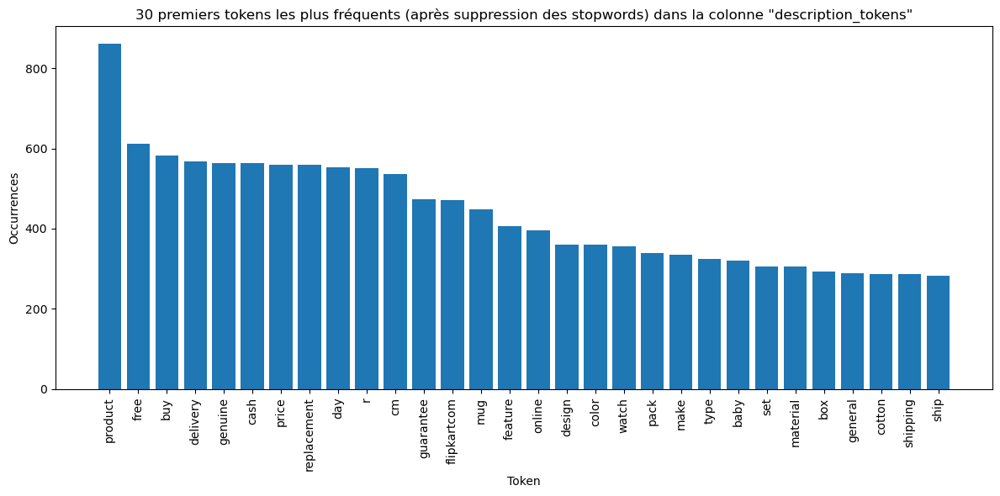

In [116]:
# Compter les occurrences de chaque token dans la colonne "description_tokens" après suppression des stopwords
description_counts = Counter(token for tokens in flipkart_df['description_tokens'] for token in tokens)

# Obtenir les 30 premiers tokens les plus fréquents
top_tokens = description_counts.most_common(30)
tokens, counts = zip(*top_tokens)

# Créer le diagramme à barres
plt.figure(figsize=(12, 6))
plt.bar(tokens, counts)
plt.xticks(rotation=90)
plt.xlabel('Token')
plt.ylabel('Occurrences')
plt.title('30 premiers tokens les plus fréquents (après suppression des stopwords) dans la colonne "description_tokens"')
plt.tight_layout()
plt.savefig('30_description_tokens_lemm.png')
plt.show()

- Visualisation des 30 tokens les plus fréquents dans la colonne 'product_name_tokens' après lemmatisation 

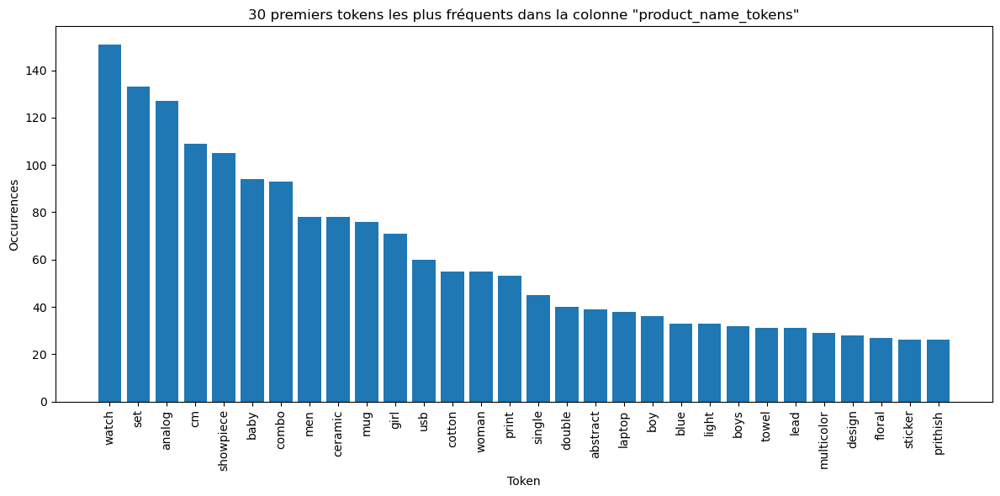

In [117]:
# Compter les occurrences de chaque token dans la colonne "product_name_tokens"
product_name_counts = Counter(token for tokens in flipkart_df['product_name_tokens'] for token in tokens)

# Obtenir les 30 premiers tokens les plus fréquents
top_tokens = product_name_counts.most_common(30)
tokens, counts = zip(*top_tokens)

# Créer le diagramme à barres
plt.figure(figsize=(12, 6))
plt.bar(tokens, counts)
plt.xticks(rotation=90)
plt.xlabel('Token')
plt.ylabel('Occurrences')
plt.title('30 premiers tokens les plus fréquents dans la colonne "product_name_tokens"')
plt.savefig('30_product_name_tokens_lemm.png')
plt.tight_layout()
plt.show()

- Visualisation via un nuage des tokens après lemmatisation

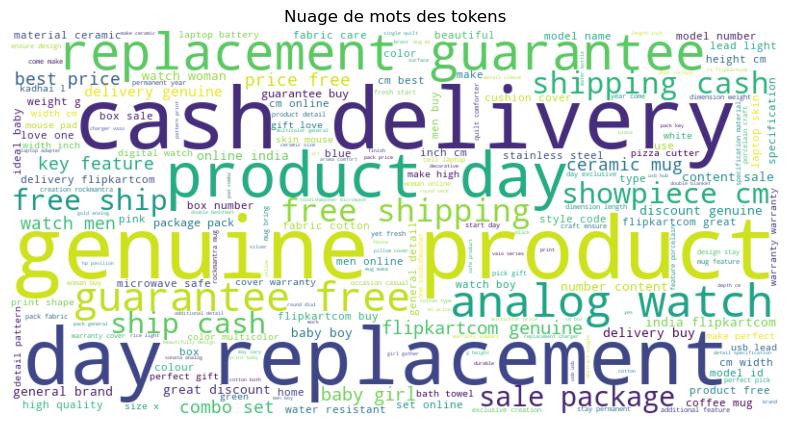

In [115]:
# Concaténer tous les tokens en une seule chaîne de caractères
all_tokens = flipkart_df['description_tokens'].sum() + flipkart_df['product_name_tokens'].sum()
text = ' '.join(all_tokens)

# Créer le nuage de mots
wordcloud = WordCloud(background_color="white", width=800, height=400).generate(text)

# Afficher le nuage de mots
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.title('Nuage de mots des tokens')
plt.savefig('30_wCloud_lemm.png')
plt.show()

- Visualisation en diagramme en secteurs des 10 tokens les plus fréquents dans la colonne 'description_tokens' après nettoyage 

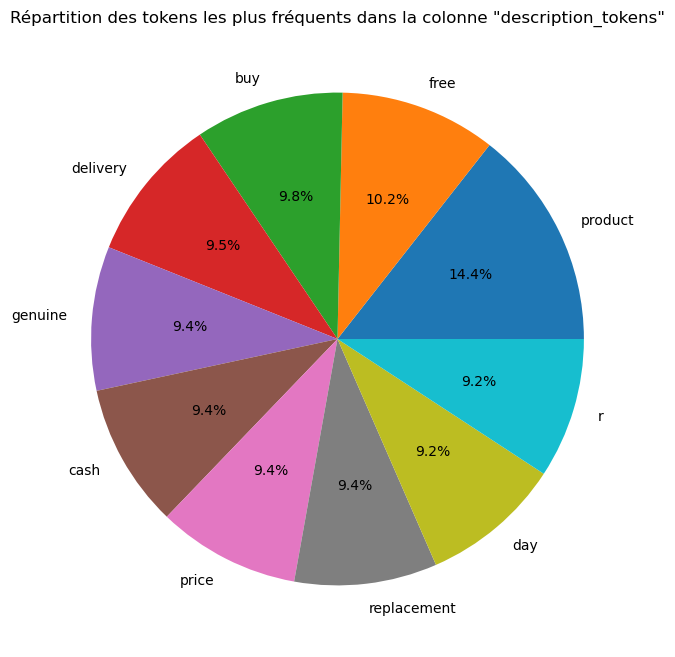

In [118]:
# Compter les occurrences de chaque token dans la colonne "description_tokens"
description_counts = Counter(token for tokens in flipkart_df['description_tokens'] for token in tokens)

# Obtenir les 10 premiers tokens les plus fréquents
top_tokens = description_counts.most_common(10)
tokens, counts = zip(*top_tokens)

# Créer le diagramme en secteurs
plt.figure(figsize=(8, 8))
plt.pie(counts, labels=tokens, autopct='%1.1f%%')
plt.title('Répartition des tokens les plus fréquents dans la colonne "description_tokens"')
plt.savefig('10_description_tokens_cleaned.png')
plt.show()

- Visualisation en diagramme en secteurs des 10 tokens les plus fréquents dans la colonne 'description_tokens' après nettoyage 

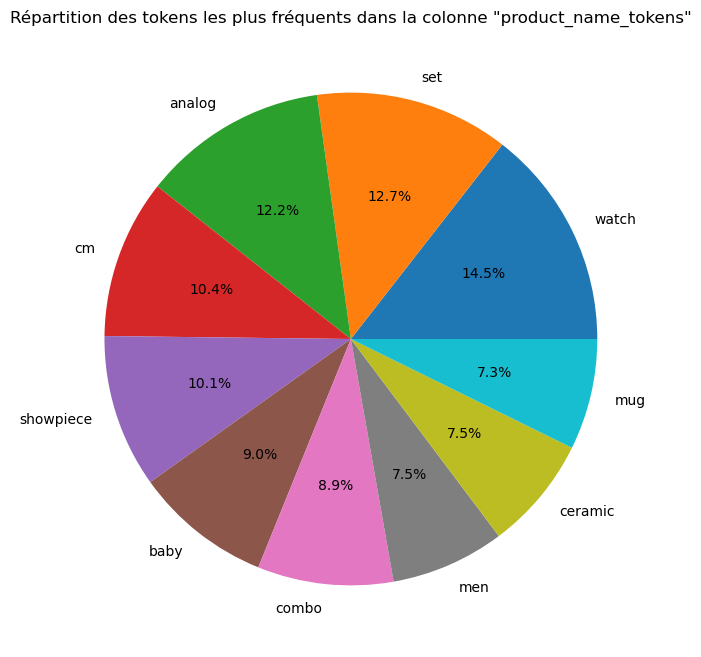

In [119]:
# Compter les occurrences de chaque token dans la colonne "description_tokens"
description_counts = Counter(token for tokens in flipkart_df['product_name_tokens'] for token in tokens)

# Obtenir les 10 premiers tokens les plus fréquents
top_tokens = description_counts.most_common(10)
tokens, counts = zip(*top_tokens)

# Créer le diagramme en secteurs
plt.figure(figsize=(8, 8))
plt.pie(counts, labels=tokens, autopct='%1.1f%%')
plt.title('Répartition des tokens les plus fréquents dans la colonne "product_name_tokens"')
plt.savefig('10_product_name_tokens.png')
plt.show()

### Sauvegarde du dataset après le traitement de la lemmatisation pour d'autres traitement à venir

In [121]:
# Enregistrement du DataFrame dans un nouveau fichier CSV
flipkart_df.to_csv('data/Flipkart/flipkart_lemmatized.csv', index=False)

In [35]:
flipkart_df

,uniq_id,product_name,description,product_category_tree,description_tokens,product_name_tokens
0,55b85ea15a1536d46b7190ad6fff8ce7,elegance polyester multicolor abstract eyelet ...,key features of elegance polyester multicolor ...,Home Furnishing,"[key, feature, elegance, polyester, multicolor...","[elegance, polyester, multicolor, abstract, ey..."
1,7b72c92c2f6c40268628ec5f14c6d590,sathiyas cotton bath towel,specifications of sathiyas cotton bath towel 3...,Baby Care,"[specification, sathiyas, cotton, bath, towel,...","[sathiyas, cotton, bath, towel]"
2,64d5d4a258243731dc7bbb1eef49ad74,eurospa cotton terry face towel set,key features of eurospa cotton terry face towe...,Baby Care,"[key, feature, eurospa, cotton, terry, face, t...","[eurospa, cotton, terry, face, towel, set]"
3,d4684dcdc759dd9cdf41504698d737d8,santosh royal fashion cotton printed king size...,key features of santosh royal fashion cotton p...,Home Furnishing,"[key, feature, santosh, royal, fashion, cotton...","[santosh, royal, fashion, cotton, print, king,..."
4,6325b6870c54cd47be6ebfbffa620ec7,jaipur print cotton floral king sized double b...,key features of jaipur print cotton floral kin...,Home Furnishing,"[key, feature, jaipur, print, cotton, floral, ...","[jaipur, print, cotton, floral, king, size, do..."
...,...,...,...,...,...,...
1045,958f54f4c46b53c8a0a9b8167d9140bc,oren empower extra large self adhesive sticker,oren empower extra large self adhesive sticker...,Baby Care,"[oren, empower, extra, large, self, adhesive, ...","[oren, empower, extra, large, self, adhesive, ..."
1046,fd6cbcc22efb6b761bd564c28928483c,wallmantra large vinyl sticker sticker,wallmantra large vinyl sticker sticker pack of...,Baby Care,"[wallmantra, large, vinyl, sticker, sticker, p...","[wallmantra, large, vinyl, sticker, sticker]"
1047,5912e037d12774bb73a2048f35a00009,uberlyfe extra large pigmented polyvinyl films...,buy uberlyfe extra large pigmented polyvinyl f...,Baby Care,"[buy, uberlyfe, extra, large, pigment, polyvin...","[uberlyfe, extra, large, pigment, polyvinyl, f..."
1048,c3edc504d1b4f0ba6224fa53a43a7ad6,wallmantra medium vinyl sticker sticker,buy wallmantra medium vinyl sticker sticker fo...,Baby Care,"[buy, wallmantra, medium, vinyl, sticker, stic...","[wallmantra, medium, vinyl, sticker, sticker]"


### Construire des features du type bag-of-words (à l'aide d'algo CountVectorizer)

- Extraction des caractéristiques de texte en utilisant CountVectorizer sur les descriptions et noms de produits lemmatisés

In [123]:
# Concaténer les tokens lemmatisés en une seule chaîne par ligne
flipkart_df['description_lemmatized'] = flipkart_df['description_tokens'].apply(lambda tokens: ' '.join(tokens))
flipkart_df['product_name_lemmatized'] = flipkart_df['product_name_tokens'].apply(lambda tokens: ' '.join(tokens))

# Créer un objet CountVectorizer
count_vectorizer = CountVectorizer()

# Appliquer le CountVectorizer sur les colonnes lemmatisées
description_features = count_vectorizer.fit_transform(flipkart_df['description_lemmatized'])
product_name_features = count_vectorizer.fit_transform(flipkart_df['product_name_lemmatized'])

# Afficher les caractéristiques extraites
print(description_features)
print(product_name_features)

  (0, 2199)	1
  (0, 1496)	2
  (0, 1296)	3
  (0, 3109)	6
  (0, 2666)	4
  (0, 15)	4
  (0, 1442)	6
  (0, 1194)	5
  (0, 996)	10
  (0, 1576)	1
  (0, 997)	1
  (0, 762)	3
  (0, 1886)	2
  (0, 2912)	3
  (0, 3178)	1
  (0, 1331)	1
  (0, 2386)	1
  (0, 2094)	1
  (0, 2456)	2
  (0, 1900)	1
  (0, 3274)	1
  (0, 1451)	1
  (0, 3990)	1
  (0, 3948)	1
  (0, 2551)	1
  :	:
  (1048, 630)	1
  (1048, 1072)	1
  (1048, 395)	1
  (1048, 3699)	1
  (1048, 2528)	2
  (1048, 3944)	4
  (1048, 4407)	2
  (1048, 4445)	2
  (1049, 3178)	1
  (1049, 3207)	1
  (1049, 560)	1
  (1049, 2839)	1
  (1049, 1707)	1
  (1049, 1037)	1
  (1049, 3410)	1
  (1049, 1808)	1
  (1049, 1623)	1
  (1049, 630)	1
  (1049, 1072)	1
  (1049, 395)	1
  (1049, 3699)	1
  (1049, 2273)	2
  (1049, 3944)	2
  (1049, 4407)	2
  (1049, 4299)	2
  (0, 468)	1
  (0, 1206)	1
  (0, 1031)	1
  (0, 3)	1
  (0, 512)	1
  (0, 434)	1
  (0, 368)	1
  (1, 1378)	1
  (1, 343)	1
  (1, 120)	1
  (1, 1610)	1
  (2, 343)	1
  (2, 1610)	1
  (2, 493)	1
  (2, 1581)	1
  (2, 516)	1
  (2, 1397)	1
  

- Combinaison des caractéristiques textuelles des descriptions et noms de produits pour une représentation unifiée des produits

In [124]:
# Créer un objet CountVectorizer
count_vectorizer = CountVectorizer()

# Appliquer le CountVectorizer sur les colonnes lemmatisées
description_features = count_vectorizer.fit_transform(flipkart_df['description_lemmatized'])
product_name_features = count_vectorizer.fit_transform(flipkart_df['product_name_lemmatized'])

# Concaténer les caractéristiques extraites pour chaque produit
product_features = hstack((description_features, product_name_features))

# Afficher les caractéristiques combinées
print(product_features)

  (0, 2199)	1
  (0, 1496)	2
  (0, 1296)	3
  (0, 3109)	6
  (0, 2666)	4
  (0, 15)	4
  (0, 1442)	6
  (0, 1194)	5
  (0, 996)	10
  (0, 1576)	1
  (0, 997)	1
  (0, 762)	3
  (0, 1886)	2
  (0, 2912)	3
  (0, 3178)	1
  (0, 1331)	1
  (0, 2386)	1
  (0, 2094)	1
  (0, 2456)	2
  (0, 1900)	1
  (0, 3274)	1
  (0, 1451)	1
  (0, 3990)	1
  (0, 3948)	1
  (0, 2551)	1
  :	:
  (1045, 5486)	1
  (1045, 6013)	1
  (1045, 5129)	1
  (1045, 5736)	1
  (1045, 5098)	1
  (1046, 6131)	2
  (1046, 5486)	1
  (1046, 6303)	1
  (1046, 6319)	1
  (1047, 6131)	1
  (1047, 5486)	1
  (1047, 5129)	1
  (1047, 6260)	1
  (1047, 5797)	1
  (1047, 5828)	1
  (1047, 5164)	1
  (1047, 5361)	1
  (1048, 5600)	1
  (1048, 6131)	2
  (1048, 6303)	1
  (1048, 6319)	1
  (1049, 6131)	1
  (1049, 5486)	1
  (1049, 6303)	1
  (1049, 6260)	1


- Visualisation de la projection 2D des produits utilisant t-SNE sur les caractéristiques textuelles combinées

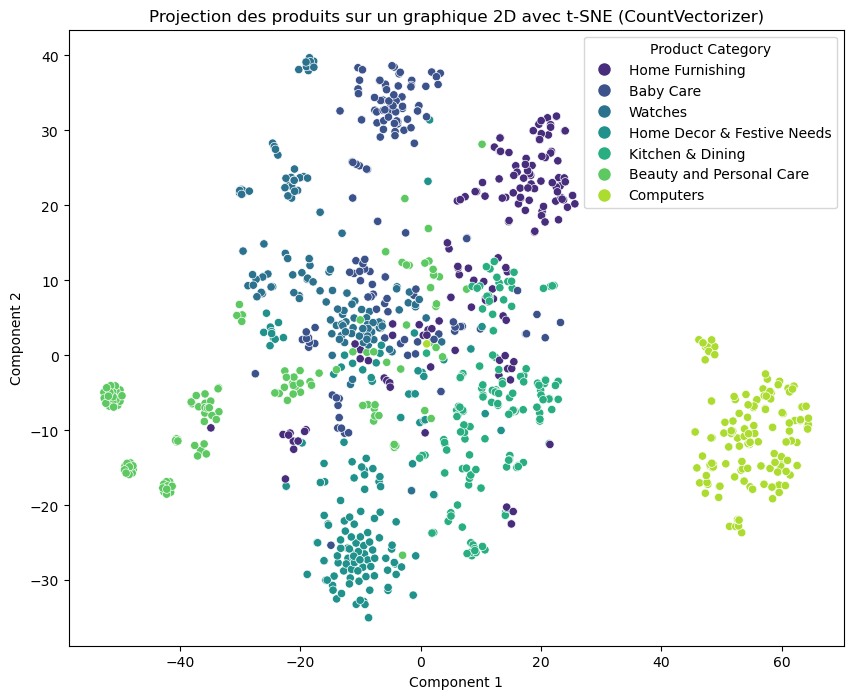

In [126]:
# Réduction en 2 dimensions avec t-SNE pour les caractéristiques combinées
tsne = TSNE(n_components=2, init='random', learning_rate=200 , random_state=42)
product_features_2d = tsne.fit_transform(product_features)

# Convertir les catégories en nombres entiers pour représenter les couleurs
label_encoder = LabelEncoder()
category_labels = label_encoder.fit_transform(flipkart_df['product_category_tree'])

# Obtenez les noms uniques de la variable 'product_category_tree'
category_names = flipkart_df['product_category_tree'].unique()

# Créer une figure
plt.figure(figsize=(10, 8))

# Utiliser seaborn pour la coloration des points en fonction des catégories
unique_categories = np.unique(category_labels)
num_categories = len(unique_categories)
colors = sns.color_palette('viridis', num_categories)
sns.scatterplot(x=product_features_2d[:, 0], y=product_features_2d[:, 1], hue=category_labels, palette=colors)

# Ajouter une légende avec les noms des catégories
legend_handles = []
for i, category in enumerate(category_names):
    handle = plt.Line2D([], [], marker='o', color='white', markerfacecolor=colors[i], markersize=10)
    legend_handles.append(handle)
plt.legend(legend_handles, category_names, title='Product Category')

# Afficher le graphique
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.title('Projection des produits sur un graphique 2D avec t-SNE (CountVectorizer)')
plt.savefig('t-SNE_CountVectorizer.png')
plt.show()

- Visualisation de la projection 2D des produits avec le clustering K-Means et l'évaluation par l'indice Rand ajusté (ARI)

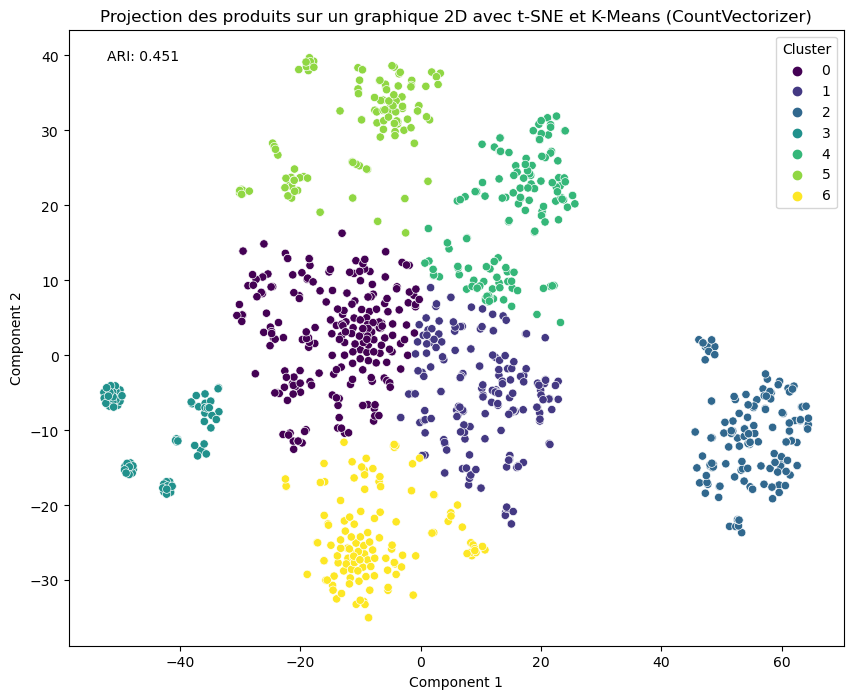

In [127]:
# Appliquer K-Means avec k=7 sur les deux composantes du t-SNE
kmeans = KMeans(n_clusters=7, random_state=42)
clusters = kmeans.fit_predict(product_features_2d)

# Convertir les catégories en nombres entiers pour représenter les couleurs
label_encoder = LabelEncoder()
category_labels = label_encoder.fit_transform(flipkart_df['product_category_tree'])

# Calculer le score ARI (Adjusted Rand Index)
ari = adjusted_rand_score(category_labels, clusters)

# Créer une figure
plt.figure(figsize=(10, 8))

# Utiliser seaborn pour la coloration des points selon les clusters
sns.scatterplot(x=product_features_2d[:, 0], y=product_features_2d[:, 1], hue=clusters, palette='viridis')

# Ajouter une légende
plt.legend(title='Cluster')

# Afficher le score ARI
plt.text(0.05, 0.95, f'ARI: {ari:.3f}', transform=plt.gca().transAxes)

# Afficher le graphique
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.title('Projection des produits sur un graphique 2D avec t-SNE et K-Means (CountVectorizer)')
plt.savefig('K-Means_CountVectorizer.png')
plt.show()

### Construire des features du type bag-of-words (TfidfVectorizer)

- Extraction des caractéristiques de texte en utilisant CountVectorizer sur les descriptions et noms de produits lemmatisés

In [128]:
# Concaténer les tokens lemmatisés en une seule chaîne par ligne
flipkart_df['description_lemmatized'] = flipkart_df['description_tokens'].apply(lambda tokens: ' '.join(tokens))
flipkart_df['product_name_lemmatized'] = flipkart_df['product_name_tokens'].apply(lambda tokens: ' '.join(tokens))

# Créer un objet TfidfVectorizer
tfidf_vectorizer = TfidfVectorizer()

# Appliquer le TfidfVectorizer sur les colonnes lemmatisées
description_features = tfidf_vectorizer.fit_transform(flipkart_df['description_lemmatized'])
product_name_features = tfidf_vectorizer.fit_transform(flipkart_df['product_name_lemmatized'])

# Afficher les caractéristiques extraites
print(description_features)
print(product_name_features)

  (0, 2498)	0.028118047366053153
  (0, 448)	0.039513067910134154
  (0, 2913)	0.05472435617578417
  (0, 3559)	0.054627287324424685
  (0, 887)	0.03160899569095123
  (0, 2788)	0.027459915360677885
  (0, 482)	0.025909269785829605
  (0, 2313)	0.039361954908240356
  (0, 1142)	0.03146503014857448
  (0, 793)	0.026886505862014166
  (0, 1982)	0.04208223675862049
  (0, 3654)	0.03063984713689398
  (0, 2703)	0.03571330700620896
  (0, 2606)	0.06293006029714895
  (0, 4297)	0.026475835776831675
  (0, 493)	0.02755855762108379
  (0, 1701)	0.024555916121221207
  (0, 4021)	0.07738921478692264
  (0, 134)	0.07000491823871857
  (0, 3465)	0.05592387259576378
  (0, 1712)	0.04309760355441303
  (0, 2335)	0.04170172173747601
  (0, 1527)	0.07306967821201858
  (0, 3834)	0.07738921478692264
  (0, 516)	0.04602125831238006
  :	:
  (1048, 1808)	0.06531162514986724
  (1048, 3410)	0.06395402758910926
  (1048, 1037)	0.06221949207391794
  (1048, 1707)	0.05878790213406746
  (1048, 2839)	0.07223383391443211
  (1048, 560)	0.0

- Combinaison des caractéristiques textuelles des descriptions et noms de produits pour une représentation unifiée des produits

In [129]:
# Concaténer les tokens lemmatisés en une seule chaîne par ligne
flipkart_df['description_lemmatized'] = flipkart_df['description_tokens'].apply(lambda tokens: ' '.join(tokens))
flipkart_df['product_name_lemmatized'] = flipkart_df['product_name_tokens'].apply(lambda tokens: ' '.join(tokens))

# Créer un objet TfidfVectorizer
tfidf_vectorizer = TfidfVectorizer()

# Appliquer le TfidfVectorizer sur les colonnes lemmatisées
description_features = tfidf_vectorizer.fit_transform(flipkart_df['description_lemmatized'])
product_name_features = tfidf_vectorizer.fit_transform(flipkart_df['product_name_lemmatized'])

# Concaténer les caractéristiques extraites pour chaque produit
product_features = hstack((description_features, product_name_features))

# Afficher les caractéristiques combinées
print(product_features)

  (0, 2498)	0.028118047366053153
  (0, 448)	0.039513067910134154
  (0, 2913)	0.05472435617578417
  (0, 3559)	0.054627287324424685
  (0, 887)	0.03160899569095123
  (0, 2788)	0.027459915360677885
  (0, 482)	0.025909269785829605
  (0, 2313)	0.039361954908240356
  (0, 1142)	0.03146503014857448
  (0, 793)	0.026886505862014166
  (0, 1982)	0.04208223675862049
  (0, 3654)	0.03063984713689398
  (0, 2703)	0.03571330700620896
  (0, 2606)	0.06293006029714895
  (0, 4297)	0.026475835776831675
  (0, 493)	0.02755855762108379
  (0, 1701)	0.024555916121221207
  (0, 4021)	0.07738921478692264
  (0, 134)	0.07000491823871857
  (0, 3465)	0.05592387259576378
  (0, 1712)	0.04309760355441303
  (0, 2335)	0.04170172173747601
  (0, 1527)	0.07306967821201858
  (0, 3834)	0.07738921478692264
  (0, 516)	0.04602125831238006
  :	:
  (1045, 5129)	0.3932343893874289
  (1045, 6013)	0.3274911560911102
  (1045, 5486)	0.3597458223269377
  (1045, 6131)	0.294002589030619
  (1045, 4632)	0.3798810174072152
  (1046, 6319)	0.413792

- Visualisation de la projection 2D des produits utilisant t-SNE sur les caractéristiques textuelles combinées

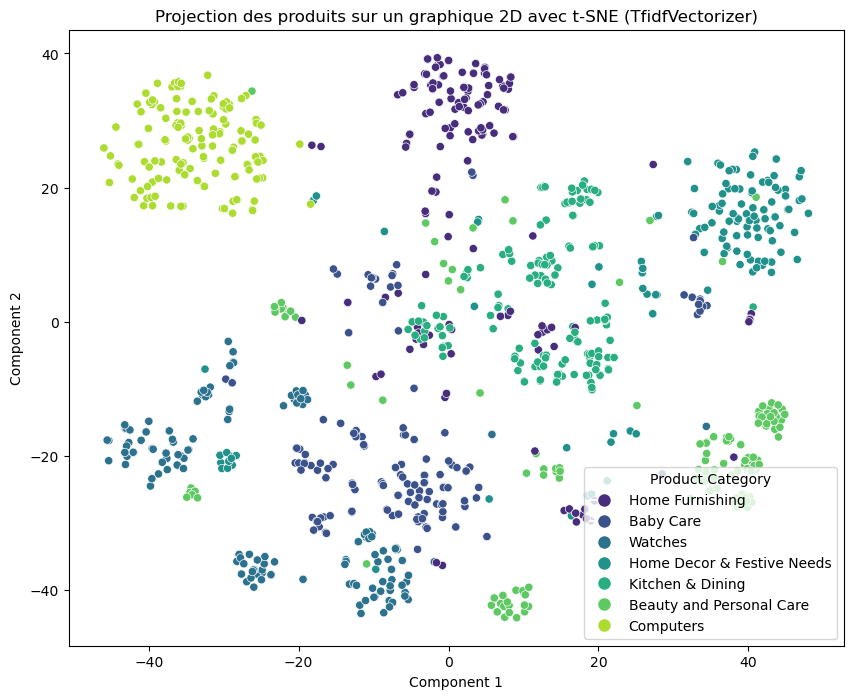

In [130]:
# Réduction en 2 dimensions avec t-SNE pour les caractéristiques combinées
tsne = TSNE(n_components=2, init='random', learning_rate=200 , random_state=42)
product_features_2d = tsne.fit_transform(product_features)

# Convertir les catégories en nombres entiers pour représenter les couleurs
label_encoder = LabelEncoder()
category_labels = label_encoder.fit_transform(flipkart_df['product_category_tree'])

# Obtenez les noms uniques de la variable 'product_category_tree'
category_names = flipkart_df['product_category_tree'].unique()

# Créer une figure
plt.figure(figsize=(10, 8))

# Utiliser seaborn pour la coloration des points en fonction des catégories
unique_categories = np.unique(category_labels)
num_categories = len(unique_categories)
colors = sns.color_palette('viridis', num_categories)
sns.scatterplot(x=product_features_2d[:, 0], y=product_features_2d[:, 1], hue=category_labels, palette=colors)

# Ajouter une légende avec les noms des catégories
legend_handles = []
for i, category in enumerate(category_names):
    handle = plt.Line2D([], [], marker='o', color='white', markerfacecolor=colors[i], markersize=10)
    legend_handles.append(handle)
plt.legend(legend_handles, category_names, title='Product Category')

# Afficher le graphique
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.title('Projection des produits sur un graphique 2D avec t-SNE (TfidfVectorizer)')
plt.savefig('t-SNE_TfidfVectorizer.png')
plt.show()

- Visualisation de la projection 2D des produits avec le clustering K-Means et l'évaluation par l'indice Rand ajusté (ARI)

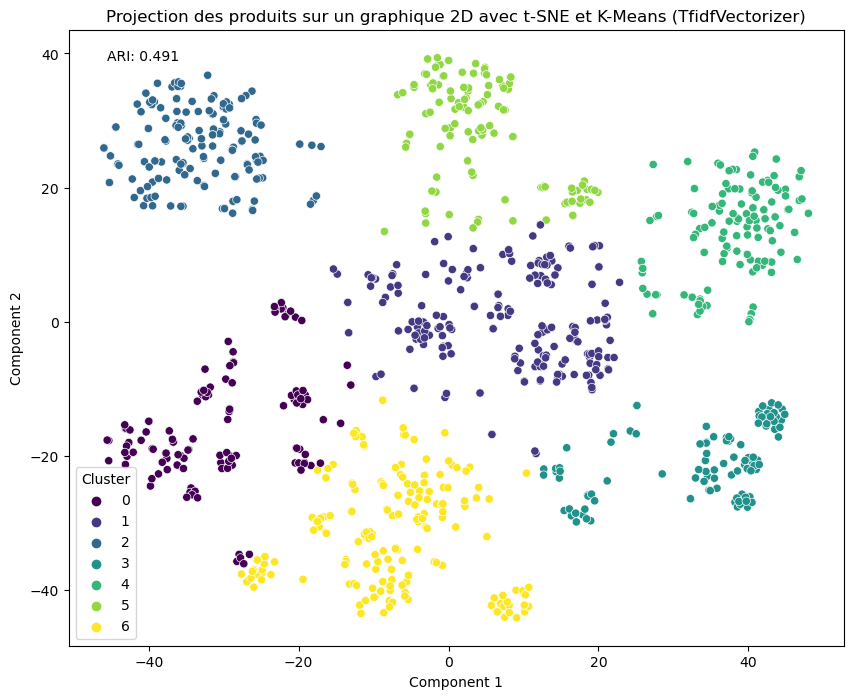

In [131]:
# Appliquer K-Means avec k=7 sur les deux composantes du t-SNE
kmeans = KMeans(n_clusters=7, random_state=42)
clusters = kmeans.fit_predict(product_features_2d)

# Convertir les catégories en nombres entiers pour représenter les couleurs
label_encoder = LabelEncoder()
category_labels = label_encoder.fit_transform(flipkart_df['product_category_tree'])

# Calculer le score ARI (Adjusted Rand Index)
ari = adjusted_rand_score(category_labels, clusters)

# Créer une figure
plt.figure(figsize=(10, 8))

# Utiliser seaborn pour la coloration des points selon les clusters
sns.scatterplot(x=product_features_2d[:, 0], y=product_features_2d[:, 1], hue=clusters, palette='viridis')

# Ajouter une légende
plt.legend(title='Cluster')

# Afficher le score ARI
plt.text(0.05, 0.95, f'ARI: {ari:.3f}', transform=plt.gca().transAxes)

# Afficher le graphique
plt.xlabel('Component 1')
plt.ylabel('Component 2')
plt.title('Projection des produits sur un graphique 2D avec t-SNE et K-Means (TfidfVectorizer)')
plt.savefig('K-Means_TfidfVectorizer.png')
plt.show()

In [92]:
raw_descrip = flipkart_df['description_tokens'].apply(lambda tokens: " ".join(tokens)).values[0]
raw_descrip

'key feature elegance polyester multicolor abstract eyelet door curtain floral curtainelegance polyester multicolor abstract eyelet door curtain 213 cm height pack 2 price r 899 curtain enhances look interiorsthis curtain make 100 high quality polyester fabricit feature eyelet style stitch metal ringit make room environment romantic lovingthis curtain ant wrinkle anti shrinkage elegant apparancegive home bright modernistic appeal design surreal attention sure steal heart contemporary eyelet valance curtain slide smoothly draw apart first thing morning welcome bright sun ray want wish good morning whole world draw close evening create special moment joyous beauty give soothe print bring home elegant curtain softly filter light room get right amount sunlightspecifications elegance polyester multicolor abstract eyelet door curtain 213 cm height pack 2 general brand elegance design door type eyelet model name abstract polyester door curtain set 2 model id duster25 color multicolor dimensio

## Etude de faisabilité par méthode SIFT

In [14]:
#path = "data/Flipkart/Images/"
#list_photos = [file for file in os.listdir(path)]
#print(len(list_photos))

#flipkart_df = pd.read_csv('./data/Flipkart/flipkart_com-ecommerce_sample_1050.csv')
#data = flipkart_df[['image','product_category_tree']].copy()

1050


- Chargement des données et comptage du nombre d'images dans le répertoire des photos de Flipkart

In [11]:
path = "data/Flipkart/Images/"

list_photos = [file for file in listdir(path)]
print(len(list_photos))

1050


- Affichage d'un échéchantillon de 70 images

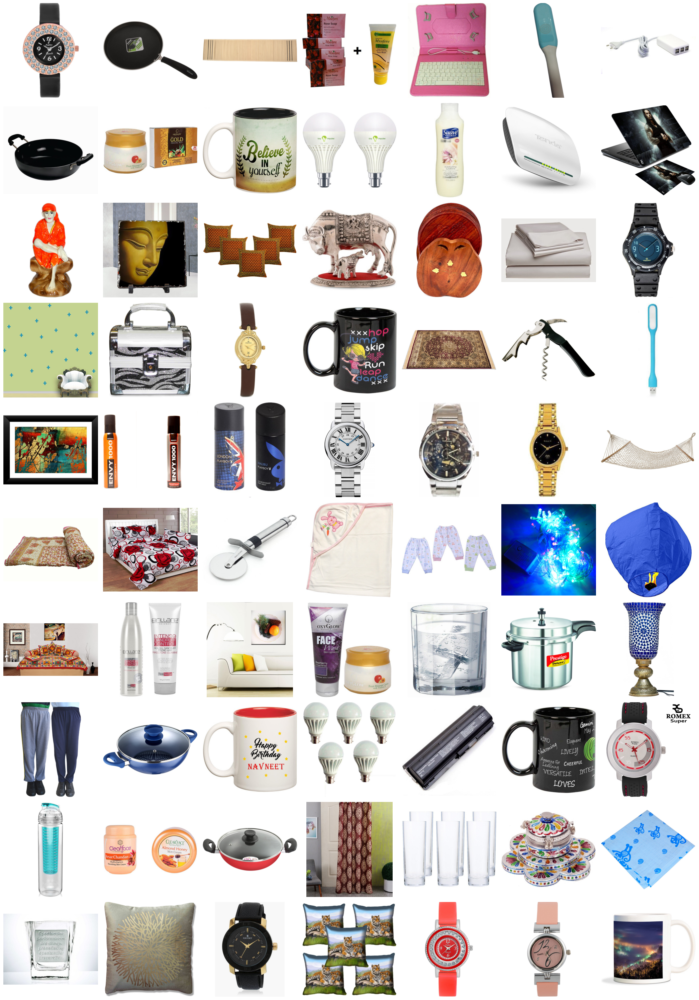

In [23]:
# Définir le nombre de lignes et de colonnes
nrows = 10
ncols = 7

# Initialiser le tracé
fig, ax = plt.subplots(nrows, ncols, figsize=(ncols*3, nrows*3))

# Assurez-vous que les axes sont aplatis pour une itération facile
ax = ax.flatten()

# Boucle à travers chaque image
for i, photo in enumerate(list_photos[:70]):
    img = mpimg.imread(os.path.join(path, photo))
    ax[i].imshow(img)
    ax[i].axis('off')

# Supprimez les sous-tracés vides le cas échéant
if len(list_photos) < nrows * ncols:
    for j in range(len(list_photos), nrows * ncols):
        fig.delaxes(ax[j])

# Afficher le tracé
plt.tight_layout()
plt.show()

# Enregistrer la figure
fig.savefig('image_grid70.png')

### Création des labels des photos à partir du nom des images

- Création d'un DataFrame contenant les chemins des images et les identifiants uniques correspondants

In [82]:
list_labels = list(set(flipkart_img_df["product_category_tree"]))

data = pd.DataFrame()
data["image_path"] = list_photos
data['uniq_id'] = data['image_path'].str.split('.jpg' , n = 1, expand=True)[0]
data

,image_path,uniq_id
0,009099b1f6e1e8f893ec29a7023153c4.jpg,009099b1f6e1e8f893ec29a7023153c4
1,0096e89cc25a8b96fb9808716406fe94.jpg,0096e89cc25a8b96fb9808716406fe94
2,00cbbc837d340fa163d11e169fbdb952.jpg,00cbbc837d340fa163d11e169fbdb952
3,00d84a518e0550612fcfcba3b02b6255.jpg,00d84a518e0550612fcfcba3b02b6255
4,00e966a5049a262cfc72e6bbf68b80e7.jpg,00e966a5049a262cfc72e6bbf68b80e7
...,...,...
1045,feefbdff924dd6b7cc266449c9a36d69.jpg,feefbdff924dd6b7cc266449c9a36d69
1046,ff24511994fc459d04145231c8876d6c.jpg,ff24511994fc459d04145231c8876d6c
1047,ffbf3794aa8cb6bb8d3f313d0a549a09.jpg,ffbf3794aa8cb6bb8d3f313d0a549a09
1048,ffc2e1fc7c886ec09a331040ada038aa.jpg,ffc2e1fc7c886ec09a331040ada038aa


- Jointure du DataFrame contenant les chemins des images avec les identifiants de produit et les catégories correspondantes

In [83]:
data = data.merge(flipkart_id_cat_df, how = 'left', on = 'uniq_id')
data.head()

,image_path,uniq_id,product_category_tree
0,009099b1f6e1e8f893ec29a7023153c4.jpg,009099b1f6e1e8f893ec29a7023153c4,Watches
1,0096e89cc25a8b96fb9808716406fe94.jpg,0096e89cc25a8b96fb9808716406fe94,Kitchen & Dining
2,00cbbc837d340fa163d11e169fbdb952.jpg,00cbbc837d340fa163d11e169fbdb952,Home Furnishing
3,00d84a518e0550612fcfcba3b02b6255.jpg,00d84a518e0550612fcfcba3b02b6255,Beauty and Personal Care
4,00e966a5049a262cfc72e6bbf68b80e7.jpg,00e966a5049a262cfc72e6bbf68b80e7,Computers


- Encodage des catégories de produits en labels numériques

In [84]:
le = preprocessing.LabelEncoder()
data["label"] = le.fit_transform(data["product_category_tree"])

- Compter le nombre d'images par catégorie de produit

In [85]:
grouped_data = data.groupby("label").count()
print(grouped_data)

       image_path  uniq_id  product_category_tree
label                                            
0             150      150                    150
1             150      150                    150
2             150      150                    150
3             150      150                    150
4             150      150                    150
5             150      150                    150
6             150      150                    150


### Affichage d'exemples d'images par label

- Affichage d'un exemple d'image pour chaque label

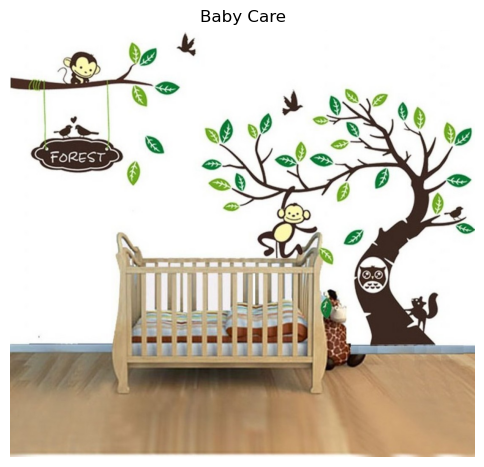

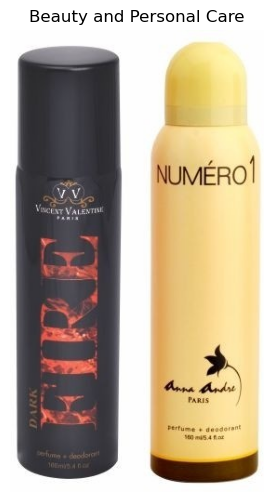

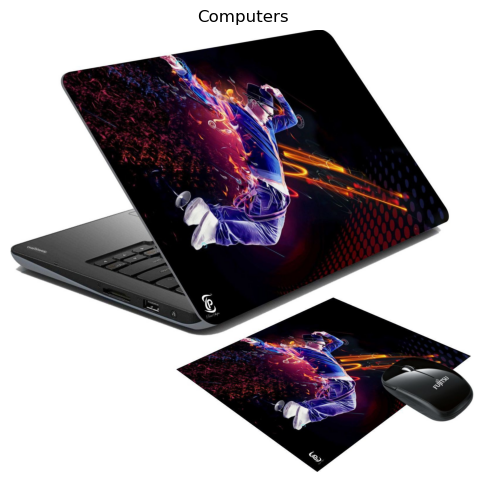

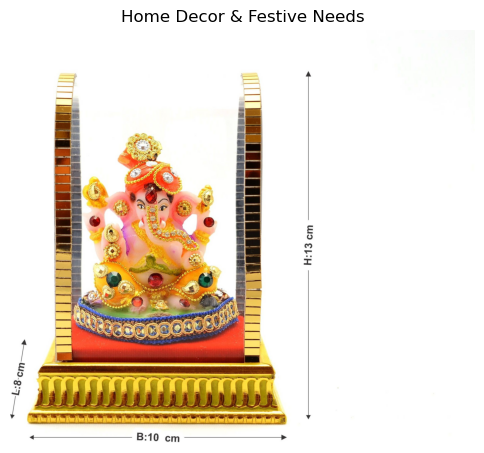

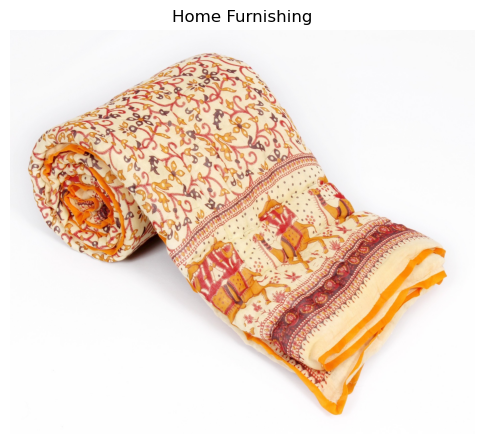

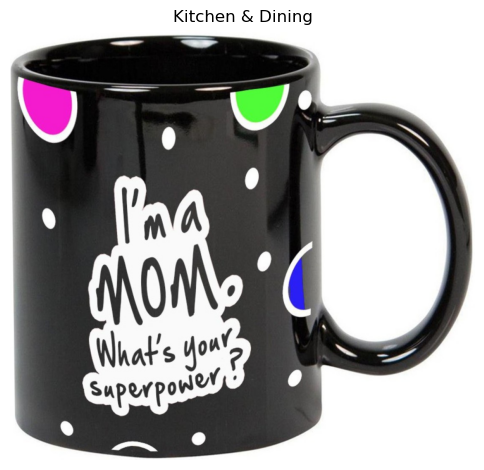

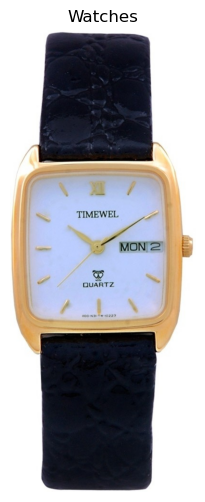

In [139]:
# DataFrame contenant un exemple de chaque classe
examples_per_class = data.groupby('label').apply(lambda x: x.sample(1))

# Affichage d'un exemple par classe
for _, row in examples_per_class.iterrows():
    # Obtenir le chemin d'une image pour la classe actuelle
    image_path_for_class = row['image_path']

    # Charger l'image
    image = cv2.imread(join(path, image_path_for_class))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Afficher l'image avec son étiquette
    plt.figure(figsize=(6, 6))
    plt.imshow(image)
    plt.title(row['product_category_tree'])
    plt.axis('off')
    
    plt.show()

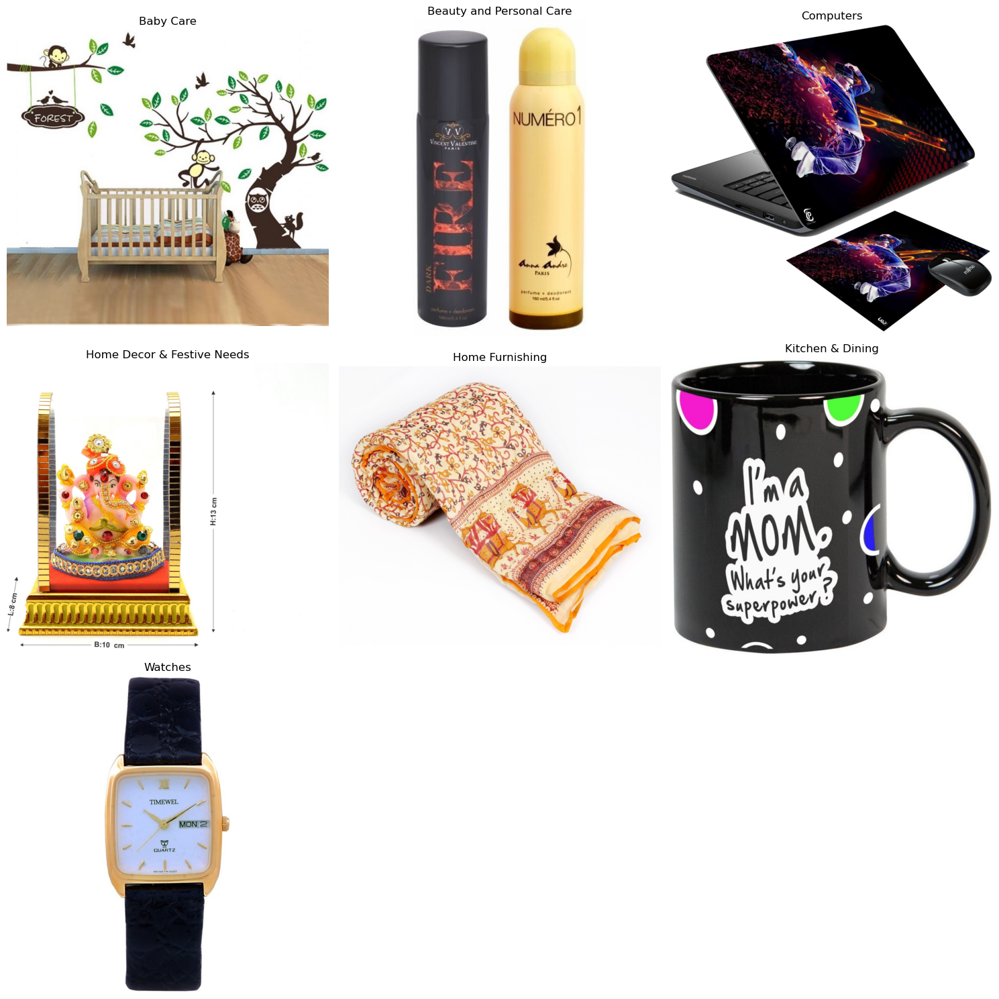

In [140]:
# Définissez le nombre de lignes et de colonnes pour votre tracé
# Par exemple, si vous avez 9 classes, vous pouvez choisir 3 lignes et 3 colonnes
nrows = 3
ncols = 3

# Initialiser le tracé
fig, ax = plt.subplots(nrows, ncols, figsize=(15, 15))

# Assurez-vous que les axes sont aplatis pour une itération facile
ax = ax.flatten()

# Boucle à travers chaque exemple de classe
for i, (_, row) in enumerate(examples_per_class.iterrows()):
    # Obtenez le chemin d'une image pour la classe actuelle
    image_path_for_class = row['image_path']

    # Charger l'image
    image = cv2.imread(join(path, image_path_for_class))
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # Afficher l'image avec son étiquette sur le sous-tracé correspondant
    ax[i].imshow(image)
    ax[i].set_title(row['product_category_tree'])
    ax[i].axis('off')

# Supprimez les sous-tracés vides le cas échéant
if len(examples_per_class) < nrows * ncols:
    for j in range(len(examples_per_class), nrows * ncols):
        fig.delaxes(ax[j])

# Afficher le tracé
plt.tight_layout()
plt.show()

# Enregistrer la figure
fig.savefig('one_img_by_label.png')

- Affichage de trois exemples d'images pour chaque label

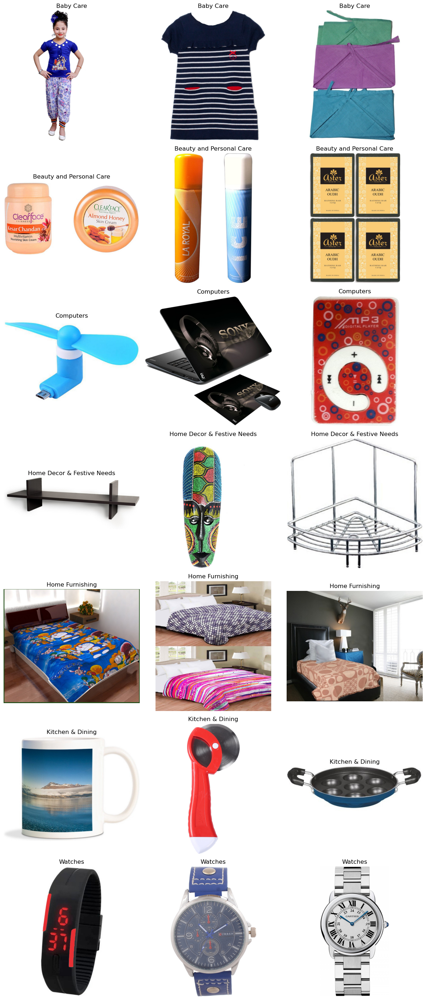

In [46]:
# DataFrame contenant trois exemples de chaque classe
examples_per_class = data.groupby('product_category_tree').apply(lambda x: x.sample(3)).reset_index(drop=True)

# Nombre total de classes
num_classes = len(examples_per_class['product_category_tree'].unique())

# Créer une figure avec une grille de sous-graphiques pour afficher les images
fig, axes = plt.subplots(nrows=num_classes, ncols=3, figsize=(12, num_classes*4))

# Parcourir chaque classe et afficher les images sur une ligne différente
for i, class_name in enumerate(examples_per_class['product_category_tree'].unique()):
    # Filtrer les exemples pour la classe actuelle
    class_data = examples_per_class[examples_per_class['product_category_tree'] == class_name]

    # Afficher les trois images de la classe sur une même ligne
    for j, (_, row) in enumerate(class_data.iterrows()):
        # Obtenir le chemin d'une image pour la classe actuelle
        image_path_for_class = row['image_path']

        # Charger l'image
        image = cv2.imread(join(path, image_path_for_class))
        image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

        # Afficher l'image sur le sous-graphique correspondant à la ligne actuelle et à la colonne j
        axes[i, j].imshow(image)
        axes[i, j].set_title(class_name)
        axes[i, j].axis('off')

# Ajuster les espacements entre les sous-graphiques pour une meilleure présentation
plt.tight_layout()

# Afficher la figure
plt.show()

### Détermination et affichage des descripteurs

- Calcul de la taille totale des descripteurs et du nombre total de points clés pour l'ensemble des images

In [47]:
# Variables pour stocker la taille totale des descripteurs et le nombre total de keypoints
total_descriptor_size = 0
total_keypoints = 0

# Parcourir toutes les images et calculer la taille des descripteurs et le nombre total de keypoints
for photo in list_photos:
    # Chemin complet de l'image
    image_path = join(path, photo)
    
    # Charger l'image en niveau de gris
    image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
    
    # Détecter les keypoints et calculer les descripteurs SIFT
    keypoints, descriptors = sift.detectAndCompute(image, None)
    
    # Vérifier si descripteurs est None, passer à l'image suivante si c'est le cas
    if descriptors is None:
        continue
    
    # Calculer la taille en octets des descripteurs pour cette image
    descriptor_size = descriptors.nbytes
    
    # Ajouter la taille des descripteurs de cette image à la taille totale des descripteurs
    total_descriptor_size += descriptor_size
    
    # Ajouter le nombre de keypoints de cette image au nombre total de keypoints
    total_keypoints += len(keypoints)

# Afficher la taille totale des descripteurs et le nombre total de keypoints pour l'ensemble des images
print("Taille totale des descripteurs pour l'ensemble des images (en octets) :", total_descriptor_size)
print("Nombre total de keypoints pour l'ensemble des images :", total_keypoints)

Taille totale des descripteurs pour l'ensemble des images (en octets) : 288995840
Nombre total de keypoints pour l'ensemble des images : 564445


- Affichage d'une image avant l'extraction des points clés SIFT

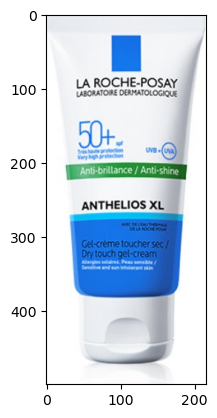

In [129]:
sift = cv2.SIFT_create()
image = cv2.imread(path+list_photos[78])
plt.imshow(image)

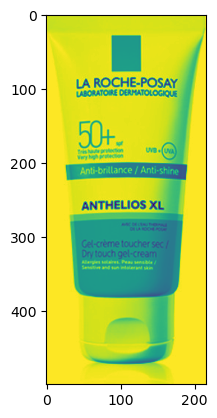

In [18]:
# conversion en gris
image = cv2.imread(path+list_photos[78],0) 
plt.imshow(image)

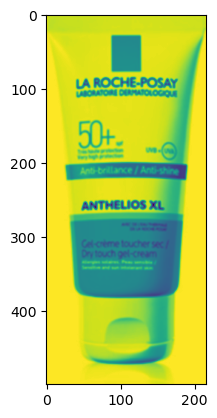

In [19]:
# Appliquer un filtre gaussien pour réduire le bruit
image = cv2.GaussianBlur(image, (5, 5), 0) 
plt.imshow(image)

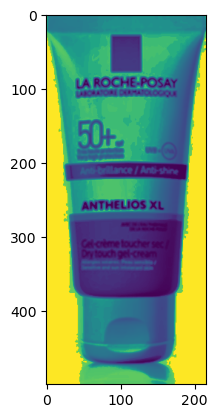

In [20]:
# Egalisation
image = cv2.equalizeHist(image)
plt.imshow(image)

- Visualisation des points clés SIFT dans une image spécifique et affichage du nombre de points clés et de la dimension des descripteurs

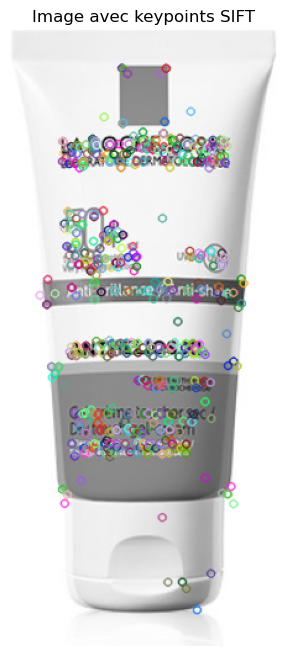

Nombre de keypoints détectés : 602
Dimension des descripteurs SIFT : (602, 128)


In [16]:
# Charger une image spécifique (par exemple, la première image du DataFrame)
image_path = join(path, data['image_path'].iloc[78])
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)

# Initialiser le détecteur SIFT
sift = cv2.SIFT_create()

# Détecter les keypoints et calculer les descripteurs SIFT pour l'image
keypoints, descriptors = sift.detectAndCompute(image, None)

# Dessiner les keypoints sur l'image
image_with_keypoints = cv2.drawKeypoints(image, keypoints, None)

# Afficher l'image avec les keypoints
plt.figure(figsize=(8, 8))
plt.imshow(image_with_keypoints, cmap='gray')
plt.title('Image avec keypoints SIFT')
plt.axis('off')
plt.show()

# Afficher le nombre de keypoints détectés et la dimension des descripteurs
print("Nombre de keypoints détectés :", len(keypoints))
print("Dimension des descripteurs SIFT :", descriptors.shape)

Exemple image2

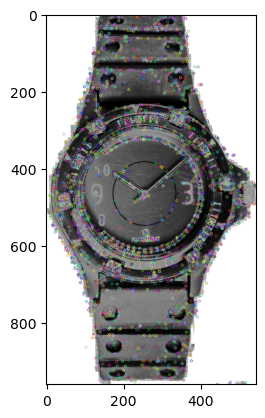

Descripteurs :  (2867, 128)

[[ 81.  90.  14. ...   0.   0.   0.]
 [ 79.  72.  14. ...   0.   3.   0.]
 [144.  18.   0. ...   0.   0.   4.]
 ...
 [  0.   0.   7. ...  24.   0.   0.]
 [ 14.  41.  40. ...   0.   0.   0.]
 [ 46.   0.   0. ...   0.   0.   0.]]


In [23]:
sift = cv2.xfeatures2d.SIFT_create()
image = cv2.imread(path+list_photos[20],0) # convert in gray
image = cv2.equalizeHist(image)   # equalize image histogram
kp, des = sift.detectAndCompute(image, None)
img=cv2.drawKeypoints(image,kp,image)
plt.imshow(img)
plt.show()
print("Descripteurs : ", des.shape)
print()
print(des)

L'image contient 4656 descripteurs
et chaque descripteur est un vecteur de longueur 128

## Pré-traitement des images via SIFT

### Créations des descripteurs de chaque image

In [16]:
# Initialisation des listes pour stocker les points clés
sift_keypoints = []

# Création de l'objet SIFT
sift = cv2.xfeatures2d.SIFT_create(500)

temps1 = time.time()

# Parcours de toutes les images
for image_num in range(len(list_photos)) :
    if image_num % 100 == 0 : 
        print(image_num)
    
    # Lecture de l'image en niveaux de gris
    image = cv2.imread(path + list_photos[image_num], 0)
    
    # Vérifier si l'image a été chargée correctement
    if image is not None:
        # Égalisation de l'histogramme de l'image
        res = cv2.equalizeHist(image)
    
        # Détection des points clés et calcul des descripteurs SIFT
        kp, des = sift.detectAndCompute(res, None)
    
        # Ajout des descripteurs à la liste
        if des is not None:
            sift_keypoints.append(des)

# Convertir la liste de descripteurs en tableau numpy 2D
sift_keypoints_all = np.concatenate(sift_keypoints, axis=0)

print()
print("Nombre de descripteurs : ", sift_keypoints_all.shape)

duration1 = time.time() - temps1
print("Temps de traitement SIFT descriptor : ", "%15.2f" % duration1, "secondes")

0
100
200
300
400
500
600
700
800
900
1000

Nombre de descripteurs :  (517351, 128)
Temps de traitement SIFT descriptor :           563.84 secondes


### Création des clusters de descripteurs

In [17]:
# Determination number of clusters
k = int(round(np.sqrt(len(sift_keypoints_all)),0))
print("Nombre de clusters estimés : ", k)
print("Création de",k, "clusters de descripteurs ...")

# Clustering
kmeans = cluster.MiniBatchKMeans(n_clusters=k, init_size=3*k, random_state=0)
kmeans.fit(sift_keypoints_all)

duration1=time.time()-temps1
print("temps de traitement kmeans : ", "%15.2f" % duration1, "secondes")

Nombre de clusters estimés :  719
Création de 719 clusters de descripteurs ...


C:\Users\tidib\anaconda3\lib\site-packages\sklearn\cluster\_kmeans.py:1043: UserWarning: MiniBatchKMeans is known to have a memory leak on Windows with MKL, when there are less chunks than available threads. You can prevent it by setting batch_size >= 2048 or by setting the environment variable OMP_NUM_THREADS=4
  warnings.warn(


temps de traitement kmeans :           648.45 secondes


### Création des features des images

In [18]:
# Creation of histograms (features)
temps1=time.time()

def build_histogram(kmeans, des, image_num):
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des=len(des)
    if nb_des==0 : print("problème histogramme image  : ", image_num)
    for i in res:
        hist[i] += 1.0/nb_des
    return hist


# Creation of a matrix of histograms
hist_vectors=[]

for i, image_desc in enumerate(sift_keypoints) :
    if i%100 == 0 : print(i)  
    hist = build_histogram(kmeans, image_desc, i) #calculates the histogram
    hist_vectors.append(hist) #histogram is the feature vector

im_features = np.asarray(hist_vectors)

duration1=time.time()-temps1
print("temps de création histogrammes : ", "%15.2f" % duration1, "secondes")

0
100
200
300
400
500
600
700
800
900
1000
temps de création histogrammes :           150.21 secondes


In [ ]:
image_path
image = cv2.imread(image_path, cv2.IMREAD_GRAYSCALE)
image

- Création d'histogrammes

In [19]:
def build_histogram(kmeans, des, image_num):
    """créé un histogramme comptant le nombre de descripteurs par cluster"""
    res = kmeans.predict(des)
    hist = np.zeros(len(kmeans.cluster_centers_))
    nb_des=len(des)
    if nb_des==0 : print("problème histogramme image  : ", image_num)
    for i in res:
        hist[i] += 1.0/nb_des
    return hist

In [20]:
# Création de la matrice des histogrammes
hist_vectors=[]

for i, image_desc in enumerate(sift_keypoints) :
    hist = build_histogram(kmeans, image_desc, i)
    hist_vectors.append(hist)

im_features = np.asarray(hist_vectors)

Text(0, 0.5, 'Fréquence')

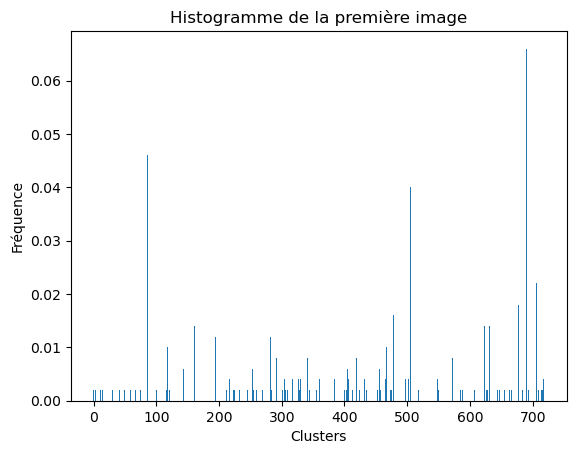

In [21]:
plt.bar(x = range(len(hist_vectors[0])),height = hist_vectors[0])
plt.title('Histogramme de la première image')
plt.xlabel('Clusters')
plt.ylabel('Fréquence')

### Réduction de dimension PCA

In [51]:
print("Dimensions dataset avant réduction PCA : ", im_features.shape)
pca = decomposition.PCA(n_components=0.99)
feat_pca= pca.fit_transform(im_features)
print("Dimensions dataset après réduction PCA : ", feat_pca.shape)

Dimensions dataset avant réduction PCA :  (1050, 719)
Dimensions dataset après réduction PCA :  (1050, 502)


### Réduction de dimension T-SNE

In [86]:
tsne = manifold.TSNE(n_components=2, perplexity=30, 
                     n_iter=2000, init='random', random_state=6, 
                     learning_rate='auto')
X_tsne = tsne.fit_transform(feat_pca)

df_tsne = pd.DataFrame(data = X_tsne, columns = ['tsne1', 'tsne2'])
df_tsne["class"] = data["product_category_tree"]
print(df_tsne.shape)


(1050, 3)


### Affichage T-SNE selon les catégories d'images

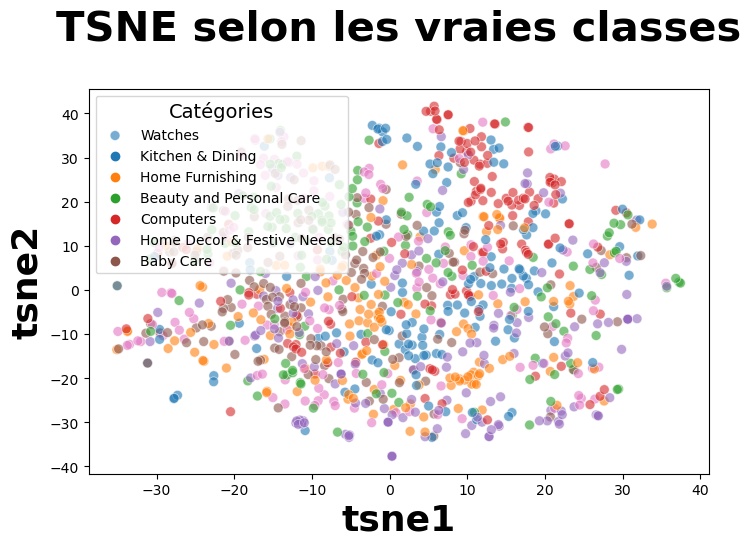

In [87]:
labels = df_tsne['class'].unique()

plt.figure(figsize=(8,5))
ax = sns.scatterplot(
    x="tsne1", y="tsne2", hue="class", data=df_tsne,
    palette=sns.color_palette('tab10', n_colors=len(labels)), s=50, alpha=0.6)

plt.title('TSNE selon les vraies classes', fontsize=30, pad=35, fontweight='bold')
plt.xlabel('tsne1', fontsize=26, fontweight='bold')
plt.ylabel('tsne2', fontsize=26, fontweight='bold')
ax.legend(title='Catégories', title_fontsize='14', labels=labels)
plt.show()


### Clustering des caractéristiques réduites des images avec K-Means et évaluation avec l'index ARI

In [88]:
cls = cluster.KMeans(n_clusters=7, random_state=6)
cls.fit(X_tsne)

df_tsne["cluster"] = cls.labels_
print(df_tsne.shape)

(1050, 4)


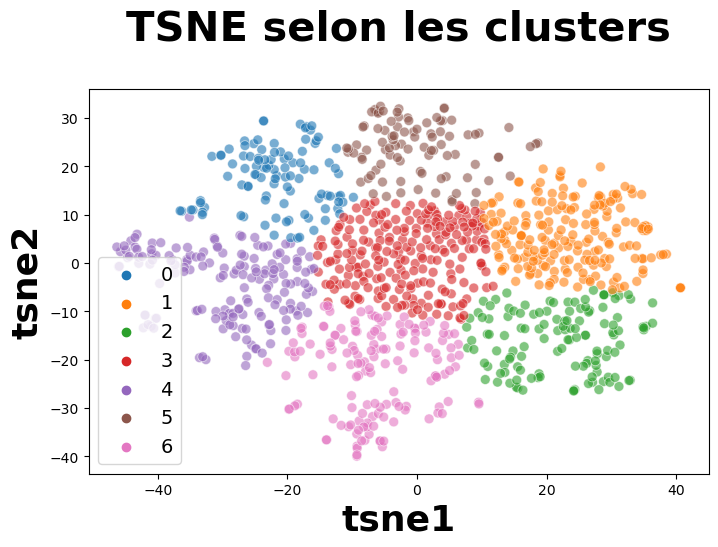

ARI :  0.0450863519269168


In [72]:
# Get the number of unique clusters in cls.labels_
n_colors = len(np.unique(cls.labels_))

plt.figure(figsize=(8,5))
sns.scatterplot(
    x="tsne1", y="tsne2",
    hue="cluster",
    palette=sns.color_palette('tab10', n_colors=n_colors), 
    s=50, alpha=0.6,
    data=df_tsne,
    legend="brief")

plt.title('TSNE selon les clusters', fontsize=30, pad=35, fontweight='bold')
plt.xlabel('tsne1', fontsize=26, fontweight='bold')
plt.ylabel('tsne2', fontsize=26, fontweight='bold')
plt.legend(prop={'size': 14})

plt.show()

labels = data["label"]
print("ARI : ", metrics.adjusted_rand_score(labels, cls.labels_))

### Analyse par classes

In [75]:
conf_mat = metrics.confusion_matrix(labels, cls.labels_)
print(conf_mat)

[[10 22 18 26 33  6 35]
 [31 11  9 22 15 42 20]
 [ 6 38 50 22  8 10 16]
 [ 6 25  4 45 38  3 29]
 [12 19 12 31 52  5 19]
 [10 53 16 37 10 13 11]
 [26 27 18 41  4 15 19]]


In [76]:
def conf_mat_transform(y_true,y_pred) :
    conf_mat = metrics.confusion_matrix(y_true,y_pred)
    
    corresp = np.argmax(conf_mat, axis=0)
    print ("Correspondance des clusters : ", corresp)
    # y_pred_transform = np.apply_along_axis(correspond_fct, 1, y_pred)
    labels = pd.Series(y_true, name="y_true").to_frame()
    labels['y_pred'] = y_pred
    labels['y_pred_transform'] = labels['y_pred'].apply(lambda x : corresp[x]) 
    
    return labels['y_pred_transform']

In [77]:
cls_labels_transform = conf_mat_transform(labels, cls.labels_)
conf_mat = metrics.confusion_matrix(labels, cls_labels_transform)
print(conf_mat)
print()
print(metrics.classification_report(labels, cls_labels_transform))

Correspondance des clusters :  [1 5 2 3 4 1 0]
[[35 16 18 26 33 22  0]
 [20 73  9 22 15 11  0]
 [16 16 50 22  8 38  0]
 [29  9  4 45 38 25  0]
 [19 17 12 31 52 19  0]
 [11 23 16 37 10 53  0]
 [19 41 18 41  4 27  0]]

              precision    recall  f1-score   support

           0       0.23      0.23      0.23       150
           1       0.37      0.49      0.42       150
           2       0.39      0.33      0.36       150
           3       0.20      0.30      0.24       150
           4       0.33      0.35      0.34       150
           5       0.27      0.35      0.31       150
           6       0.00      0.00      0.00       150

    accuracy                           0.29      1050
   macro avg       0.26      0.29      0.27      1050
weighted avg       0.26      0.29      0.27      1050



C:\Users\tidib\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  The class to report if ``average='binary'`` and the data is binary.
C:\Users\tidib\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  The class to report if ``average='binary'`` and the data is binary.
C:\Users\tidib\anaconda3\lib\site-packages\sklearn\metrics\_classification.py:1318: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  The class to report if ``average='binary'`` and the data is binary.


<Axes: >

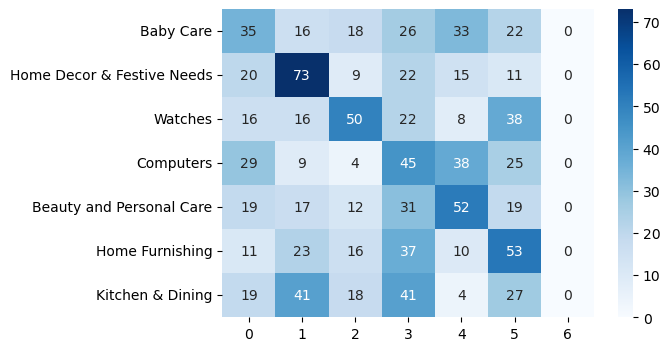

In [80]:
df_cm = pd.DataFrame(conf_mat, index = [label for label in list_labels],
                  columns = [i for i in "0123456"])
plt.figure(figsize = (6,4))
sns.heatmap(df_cm, annot=True, cmap="Blues")

La matrice de confusion confirme les résultat obtenus avec les traitements antérieurs 

In [37]:
pip install --user opencv-contrib-python

  Using cached opencv_contrib_python-4.8.0.74-cp37-abi3-win_amd64.whl (44.8 MB)
Note: you may need to restart the kernel to use updated packages.
